In [69]:
from importlib import reload

import h5py
import numpy as np
import pandas as pd

import utilities
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
from scipy.interpolate import griddata

reload(utilities)

<module 'utilities' from '/home/karim/magistere/Stage/earthquakes/New_code/utilities.py'>

# Parameters

In [70]:
hdf5_in_put_file_path = "Data/Displacements_min_mainshock_mag=6_min_stations_per_main_shock=3_min_after_shock_mag=4_after_shock_time_window=45_n_days_before_mainshock=1_n_days_after_mainshock=1_min_days_between_mainshocks=30_grid_size_km=250.hdf5"  #Path to the HDF5 output file
hdf5_out_put_file_path = "Data/Interpolated_Data_min_mainshock_mag=6_min_stations_per_main_shock=3_min_after_shock_mag=4_after_shock_time_window=45_n_days_before_mainshock=1_n_days_after_mainshock=1.hdf5"  #Path to the HDF5 output file
earth_radius = 6371  # km
grid_size_km = 250  # Size of the square grid in km
cell_size_km = 5  #Cell size in km
cell_size_rads = cell_size_km / earth_radius
cell_size_degs = cell_size_rads * 180 / np.pi
scale_factor = 1e6  # Scale factor for the coordinates from km to mm
num_cells = int(grid_size_km / cell_size_km)  # number of cells in the lateral direction
min_stations_inside = 3  # minimal number of stations inside the grid
soft_labels = False  ## smoothed labels (from {0,1} to continuous, smoothed over space)
sigma_softlabels = 1  # sigma for the gaussian smoothing of the labels, expressed in number of cell sizes
sigma_interpolation = 8  ## expressed in number of cell sizes
min_station_pixel_distance_km = 86

# Functions to build displacement maps and labels for each main shock in input HDF5 file

In [78]:
# Global storage for all aftershocks
global_aftershocks = []

def process_main_shock_data(hdf5_file_path, output_path):
    global main_shock_locations, main_shock_magnitudes, global_aftershocks
    with h5py.File(hdf5_file_path, 'r') as file:
        for id_seq in file.keys():
            main_shock_group = file[id_seq]
            aftershocks_locations = main_shock_group['aftershocks_locations'][()]
            aftershocks_magnitudes = main_shock_group['aftershocks_magnitudes'][()]

            # Append each aftershock's location and magnitude to the global list
            for location, magnitude in zip(aftershocks_locations, aftershocks_magnitudes):
                global_aftershocks.append((location, magnitude))

from collections import defaultdict
import numpy as np
import pandas as pd

def aggregate_aftershocks(grid_size_km):
    # Aggregate magnitudes by location
    location_magnitude_map = defaultdict(float)
    earth_radius_km = 6371  # Approximate radius of Earth in kilometers

    for (lat, lon), mag in global_aftershocks:
        # Convert lat, lon to a grid cell
        grid_lat = int(lat / grid_size_km * (180 / np.pi * earth_radius_km))
        grid_lon = int(lon / grid_size_km * (180 / np.pi * earth_radius_km))
        location_magnitude_map[(grid_lat, grid_lon)] += mag

    return location_magnitude_map
import matplotlib.pyplot as plt
import cartopy.crs as ccrs

def plot_aftershocks(location_magnitude_map):
    earth_radius_km = 6371
    plt.figure(figsize=(10, 5))
    ax = plt.axes(projection=ccrs.PlateCarree())
    

    # Plot each aftershock
    for (grid_lat, grid_lon), magnitude in location_magnitude_map.items():
        # Convert grid cell back to lat, lon
        lat = grid_lat * grid_size_km / (180 / np.pi * earth_radius_km)
        lon = grid_lon * grid_size_km / (180 / np.pi * earth_radius_km)
        ax.plot(lon, lat, 'ro', markersize=magnitude ** 0.5, alpha=0.6)

    ax.coastlines()

    plt.title('Cumulative Magnitudes of Aftershocks')
    picture_name = "Data/Plots/Aftershocks.png"
    plt.savefig(picture_name)
    plt.show()


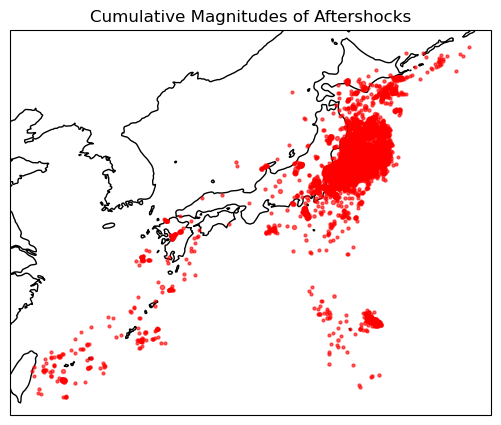

In [79]:
process_main_shock_data(hdf5_in_put_file_path, hdf5_out_put_file_path)
location_magnitude_map = aggregate_aftershocks(grid_size_km)
plot_aftershocks(location_magnitude_map)

In [73]:
## Global variables:
n_seq_init = 0  # Number of sequences processed
n_seq_discarded = 0  # Number of sequences discarded


# Add these lists to store the locations and magnitudes of the main shocks
main_shock_locations = []
main_shock_magnitudes = []

def process_main_shock_data(hdf5_file_path, output_path):
    """Process main shocks data to generate interpolated displacement maps."""
    global main_shock_locations, main_shock_magnitudes
    with h5py.File(hdf5_file_path, 'r') as file:
        for id_seq in file.keys():
            main_shock_location = file[id_seq].attrs['main_shock_location']
            main_shock_magnitude = file[id_seq].attrs['main_shock_magnitude']
            main_shock_locations.append(main_shock_location)
            main_shock_magnitudes.append(main_shock_magnitude)
            process_single_main_shock(file[id_seq], output_path, id_seq)

def plot_main_shocks(main_shock_locations = main_shock_locations, main_shock_magnitudes = main_shock_magnitudes):
    # """Plot all main shocks with varying color depending on the intensity."""
    # global main_shock_locations, main_shock_magnitudes
    # fig = plt.figure(figsize=(10, 10))
    # ax = fig.add_subplot(1, 1, 1, projection=ccrs.PlateCarree())
    # ax.coastlines()

    # # Convert the magnitudes to colors
    # magnitudes_norm = (main_shock_magnitudes - np.min(main_shock_magnitudes)) / (np.max(main_shock_magnitudes) - np.min(main_shock_magnitudes))
    # colors = plt.cm.viridis(magnitudes_norm)

    # # Plot the main shocks
    # for location, color in zip(main_shock_locations, colors):
    #     plt.plot(location[1], location[0], 'x', color=color, transform=ccrs.PlateCarree())

    # # Add a colorbar
    # sm = plt.cm.ScalarMappable(cmap=plt.cm.viridis, norm=plt.Normalize(vmin=np.min(main_shock_magnitudes), vmax=np.max(main_shock_magnitudes)))
    # sm.set_array([])
    # fig.colorbar(sm, ax=ax, orientation='vertical', label='Main Shock Magnitude')

    # plt.title('Main Shocks')

    """Plot all main shocks with varying color depending on the intensity and show a bar plot of count of main shocks by magnitude intervals."""

    
    fig = plt.figure(figsize=(15, 10))  # Adjusted size to accommodate both plots

    # First subplot for the map
    ax1 = fig.add_subplot(1, 2, 1, projection=ccrs.PlateCarree())
    ax1.coastlines()

    # Convert the magnitudes to colors
    magnitudes_norm = (main_shock_magnitudes - np.min(main_shock_magnitudes)) / (np.max(main_shock_magnitudes) - np.min(main_shock_magnitudes))
    colors = plt.cm.viridis(magnitudes_norm)

    # Plot the main shocks
    for location, color in zip(main_shock_locations, colors):
        ax1.plot(location[1], location[0], 'x', color=color, transform=ccrs.PlateCarree())

    # Add a colorbar
    sm = plt.cm.ScalarMappable(cmap=plt.cm.viridis, norm=plt.Normalize(vmin=np.min(main_shock_magnitudes), vmax=np.max(main_shock_magnitudes)))
    sm.set_array([])
    fig.colorbar(sm, ax=ax1, orientation='vertical', label='Main Shock Magnitude')

    ax1.set_title('Main Shocks')

    # Second subplot for the histogram
    ax2 = fig.add_subplot(1, 2, 2)

    # Calculate the bins for magnitude intervals [x, x+0.5]
    max_mag = np.ceil(np.max(main_shock_magnitudes) + 0.5)
    min_mag = np.floor(np.min(main_shock_magnitudes))
    bins = np.arange(min_mag, max_mag, 0.5)

    # Calculate histogram
    counts, _ = np.histogram(main_shock_magnitudes, bins=bins)

    # Plot the bar chart
    ax2.bar(bins[:-1] + 0.25, counts, width=0.5, color='blue', edgecolor='black')
    ax2.set_xticks(bins + 0.25)  # Center labels on bars
    ax2.set_xticklabels([f'{bin:.1f}-{bin+0.5:.1f}' for bin in bins])
    ax2.set_xlabel('Magnitude Intervals')
    ax2.set_ylabel('Number of Main Shocks')
    ax2.set_title('Distribution of Main Shocks by Magnitude')

    plt.tight_layout()

    picture_name = "Data/Plots/Main_Shocks.png"
    plt.savefig(picture_name)
    plt.show()
    
def calculate_interpolation_grid(main_shock_location, cell_size_degs, num_cells_half):
    min_lat = main_shock_location[0] - num_cells_half * cell_size_degs
    max_lat = main_shock_location[0] + num_cells_half * cell_size_degs
    min_lon = main_shock_location[1] - num_cells_half * cell_size_degs
    max_lon = main_shock_location[1] + num_cells_half * cell_size_degs
    n_pixels_lat = 2 * num_cells_half  # Number of discretizations in the latitude direction
    n_pixels_lon = n_pixels_lat  # Number of discretizations in the longitude direction (cells)
    return min_lat, max_lat, min_lon, max_lon, n_pixels_lat, n_pixels_lon

def plot_interpolated_data_and_main_shock(interpolated_data, main_shock_location, min_lat, max_lat, min_lon, max_lon, id_seq, main_shock_date, stations_positions, gps_stations_displacements):
    # # Calculate the norm of the interpolated data
    # norm_interpolated_data = np.linalg.norm(interpolated_data, axis=2)

    # # Create a grid of latitudes and longitudes for the interpolated data
    # lats = np.linspace(min_lat, max_lat, norm_interpolated_data.shape[0])
    # lons = np.linspace(min_lon, max_lon, norm_interpolated_data.shape[1])
    # lon_grid, lat_grid = np.meshgrid(lons, lats)

    # # Create a map using Cartopy and plot the interpolated data
    # fig = plt.figure(figsize=(10, 10))
    # ax = fig.add_subplot(1, 1, 1, projection=ccrs.PlateCarree())
    # ax.set_extent([min_lon, max_lon, min_lat, max_lat], crs=ccrs.PlateCarree())
    # ax.coastlines()

   

    # # Plot the norm of the interpolated data
    # plt.pcolormesh(lon_grid, lat_grid, norm_interpolated_data, transform=ccrs.PlateCarree())
    # plt.imshow(interpolated_data, extent=(min_lon, max_lon, min_lat, max_lat), transform=ccrs.PlateCarree(), origin='lower', cmap='jet', alpha=0.5)
   
    # plt.plot(main_shock_location[1], main_shock_location[0], 'r*', markersize=15, transform=ccrs.PlateCarree())
    # plt.scatter(stations_positions[:, 1], stations_positions[:, 0], s=30, c='red', marker = 'x', transform=ccrs.PlateCarree())
    # plt.title(f'Main Shock ID: {id_seq} on {main_shock_date}')
    # plt.colorbar(label='Norm of interpolated data')
    # picture_name = f'Data/Plots/Main Shock ID: {id_seq} on {main_shock_date}'
    # plt.savefig(picture_name)
    # plt.show()


     # Create a grid of latitudes and longitudes for the interpolated data
    lats = np.linspace(min_lat, max_lat, interpolated_data.shape[0])
    lons = np.linspace(min_lon, max_lon, interpolated_data.shape[1])
    lon_grid, lat_grid = np.meshgrid(lons, lats)

    # Create a map using Cartopy and plot the vector data
    fig = plt.figure(figsize=(10, 10))
    ax = fig.add_subplot(1, 1, 1, projection=ccrs.PlateCarree())
    ax.set_extent([min_lon, max_lon, min_lat, max_lat], crs=ccrs.PlateCarree())
    ax.coastlines()

    # Extract components for the quiver plot
    U = interpolated_data[:, :, 0]  # x-component
    V = interpolated_data[:, :, 1]  # y-component

    # Plot the vector field using quiver
    ax.quiver(lon_grid, lat_grid, U, V, transform=ccrs.PlateCarree())

    # Plot the main shock location and station positions
    ax.plot(main_shock_location[1], main_shock_location[0], 'r*', markersize=15, transform=ccrs.PlateCarree())
    ax.scatter(stations_positions[:, 1], stations_positions[:, 0], s=30, c='red', marker='x', transform=ccrs.PlateCarree())

    # Additional plotting options
    plt.title(f'Main Shock ID: {id_seq} on {main_shock_date}')
    plt.colorbar(ax.quiver(lon_grid, lat_grid, U, V, transform=ccrs.PlateCarree()), label='Vector Magnitude')
    picture_name = f'Data/Plots/Main Shock ID: {id_seq} on {main_shock_date}.png'
    plt.savefig(picture_name)
    plt.show()

    
def process_single_main_shock(main_shock_group, output_path, id_seq):
    global n_seq_init, n_seq_discarded
    n_seq_init += 1
    #print(f"Processing main shock {id_seq}...")
    gps_stations_displacements = main_shock_group['gps_stations_displacements'][()]
    # For each station, multiply the displacement by the scale factor and sum the displacements
    # over the time dimension
    ## gps_stations_displacements: (NbStations, NbDays, Displacement(X,Y,Z))
    gps_stations_displacements = (gps_stations_displacements * scale_factor)  ## convert to mm
    gps_stations_displacements = gps_stations_displacements.reshape(-1, 3)  ## (NbStations, (X,Y,Z))
    stations_positions = main_shock_group['stations_positions'][()]
    main_shock_location = main_shock_group.attrs['main_shock_location']
    after_shocks_locations = main_shock_group['aftershocks_locations'][()]
    after_shocks_locations = after_shocks_locations.reshape(-1, 2)  ## (NbAfterShocks, (X,Y))
    main_shock_day = main_shock_group.attrs['main_shock_day']
    main_shock_mag = main_shock_group.attrs['main_shock_magnitude']
    main_shock_date = main_shock_group.attrs['main_shock_day']
    stations_positions = main_shock_group['stations_positions'][()]

    # Calculate the interpolation grid
    min_lat, max_lat, min_lon, max_lon, n_pixels_lat, n_pixels_lon = calculate_interpolation_grid(
        main_shock_location, cell_size_degs, int(num_cells / 2)
    )

    # Number of stations inside the grid
    n_stations_inside_grid = ((stations_positions[:, 0] >= min_lat) & (stations_positions[:, 0] <= max_lat) &
                              (stations_positions[:, 1] >= min_lon) & (stations_positions[:, 1] <= max_lon)).sum()

    # Skip if not enough stations
    if n_stations_inside_grid < min_stations_inside:
        n_seq_discarded += 1
        #print('Skipping:', id_seq, 'with only', n_stations_inside_grid,
        #      'stations inside the grid, out of total (downloaded) ',
        #      stations_positions.shape[0])
        return

    # Interpolate the data
    labels = np.zeros((n_pixels_lat, n_pixels_lon))
    # discretize the aftershocks 
    aftershocks_rows = ((after_shocks_locations[:, 0] - min_lat) / cell_size_degs).astype('int')
    aftershocks_cols = ((after_shocks_locations[:, 1] - min_lon) / cell_size_degs).astype('int')
    # mask to make sure no event is outside the grid
    aftershocks_mask = (aftershocks_rows < n_pixels_lat) & (aftershocks_rows >= 0) & (
                aftershocks_cols < n_pixels_lon) & (
                               aftershocks_cols >= 0)
    aftershocks_rows = aftershocks_rows[aftershocks_mask]
    aftershocks_cols = aftershocks_cols[aftershocks_mask]
    if aftershocks_mask.sum() == 0:
        n_seq_discarded += 1
        #print('Skipping:', id_seq, 'with no aftershocks inside the grid')
        return
    if soft_labels:
        utilities.create_soft_labels(labels, aftershocks_rows, aftershocks_cols, cell_size_rads,
                                     sigma_softlabels * cell_size_rads)
    else:
        labels[aftershocks_rows, aftershocks_cols] = 1

    interpolated_data = np.zeros((n_pixels_lat, n_pixels_lon, 3))
    utilities.interpolate_displacements(
        interpolated_data,
        np.pi * stations_positions / 180,
        gps_stations_displacements,
        n_pixels_lat, n_pixels_lon,
        np.pi * min_lat / 180,
        np.pi * min_lon / 180,
        cell_size_rads,
        sigma_interpolation * cell_size_rads,
        min_station_pixel_distance_km
    )
    gps_stations_displacements = main_shock_group['gps_stations_displacements'][()]
    # print("Shape of gps_stations_displacements:", gps_stations_displacements.shape)
    # print("Shape of stations_positions:", stations_positions.shape)
    print(main_shock_magnitudes)
    plot_interpolated_data_and_main_shock(interpolated_data, main_shock_location, min_lat, max_lat, min_lon, max_lon, id_seq, main_shock_date, stations_positions, gps_stations_displacements)
    print(main_shock_magnitudes)
    #Save the interpolated data and labels to the output file
    save_interpolated_data(interpolated_data, labels, output_path, id_seq, main_shock_day, main_shock_mag)
    print(main_shock_magnitudes)


def save_interpolated_data(interpolated_data, labels, output_path, main_shock_id, main_shock_day, main_shock_mag):
    with h5py.File(output_path, 'a') as f:
        if str(main_shock_id) in f:
            del f[str(main_shock_id)]
        grp = f.create_group(str(main_shock_id))
        grp.attrs['main_shock_day'] = main_shock_day
        grp.attrs['main_shock_magnitude'] = main_shock_mag

        grp.create_dataset('interpolated_displacement', data=interpolated_data)
        grp.create_dataset('labels', data=labels)





def plot_gps_stations_from_csv(csv_file_path = "Data/ngl_list.csv"):
    # Read the CSV file
    gps_data = pd.read_csv(csv_file_path, sep= " " )
    print(gps_data.head())

    # Extract coordinates
    latitudes = gps_data['lat']
    longitudes = gps_data['lon']

    # Create a map projection using Cartopy
    fig, ax = plt.subplots(figsize=(10, 10), subplot_kw={'projection': ccrs.PlateCarree()})
    ax.coastlines()  # Draw coastlines for reference

    # Plotting GPS stations
    ax.set_extent([122, 154, 24, 46], crs=ccrs.PlateCarree())
    scatter = ax.scatter(longitudes, latitudes, color='dodgerblue', s=40, marker='o', edgecolor='black', label='GPS Stations', transform=ccrs.Geodetic())

    # Optional: Add legend and gridlines for better readability
    ax.legend(loc='upper right')
    ax.gridlines(draw_labels=True)

    plt.title('Map of GPS Stations')
    picture_name = "Data/Plots/GPS_Stations.png"
    plt.savefig(picture_name)
    plt.show()



   name      lat       lon       begin         end
0  00NA -12.4666  130.8440  2008-03-27  2018-09-25
1  01NA -12.4782  130.9820  2008-04-08  2019-09-29
2  02NA -12.3559  130.8817  2008-09-22  2016-12-31
3  0ABI  68.3543   18.8164  2009-06-11  2024-05-18
4  0ABN  65.0337   21.3329  2023-04-05  2024-05-18


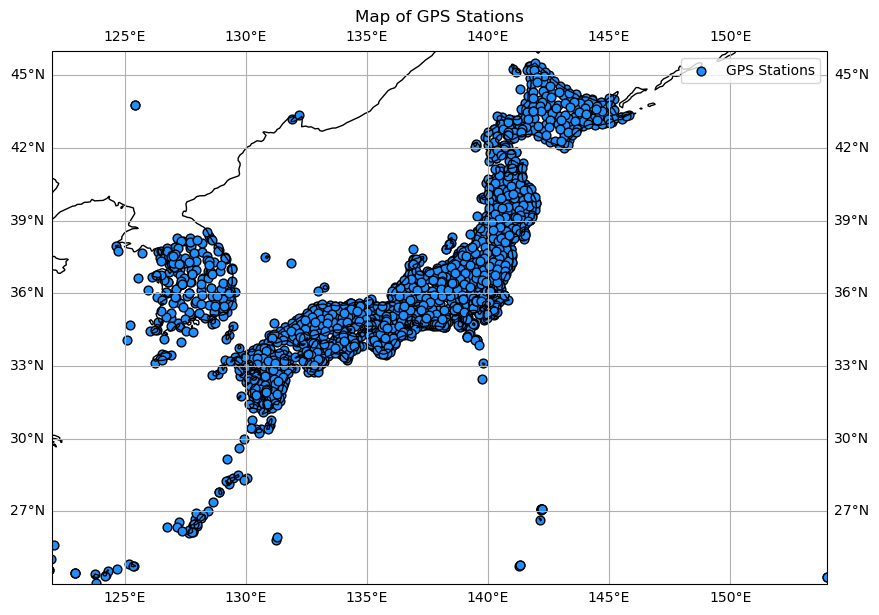

In [74]:
plot_gps_stations_from_csv()

# Main

[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4]


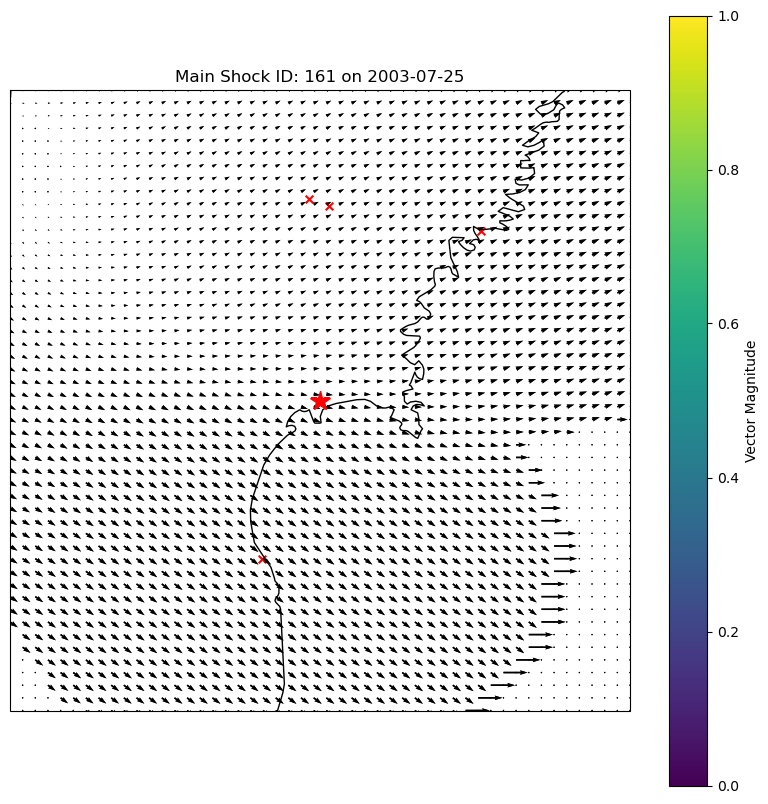

[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4]
[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4]
[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1]


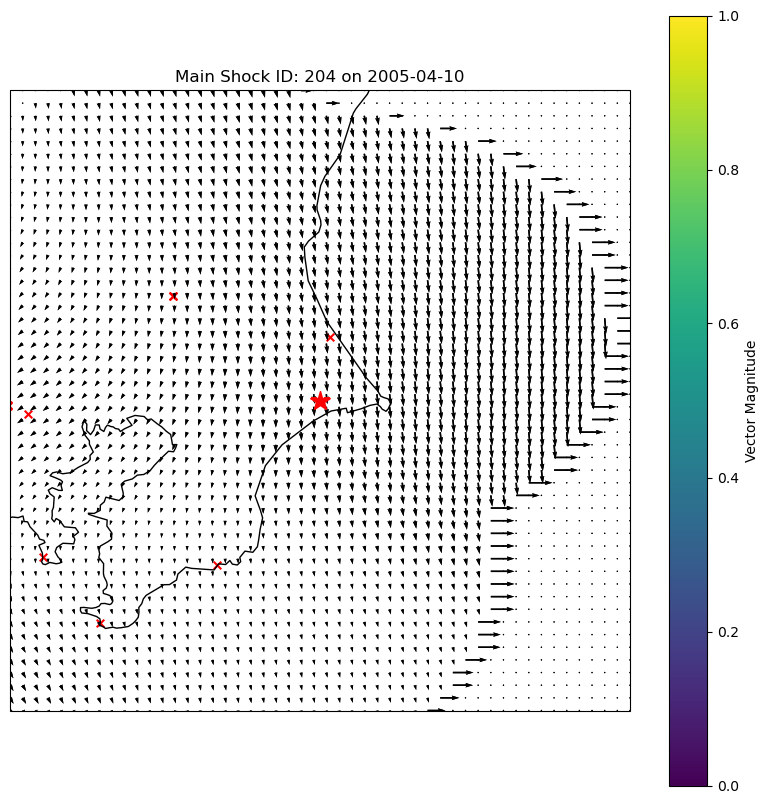

[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1]
[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1]
[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0]


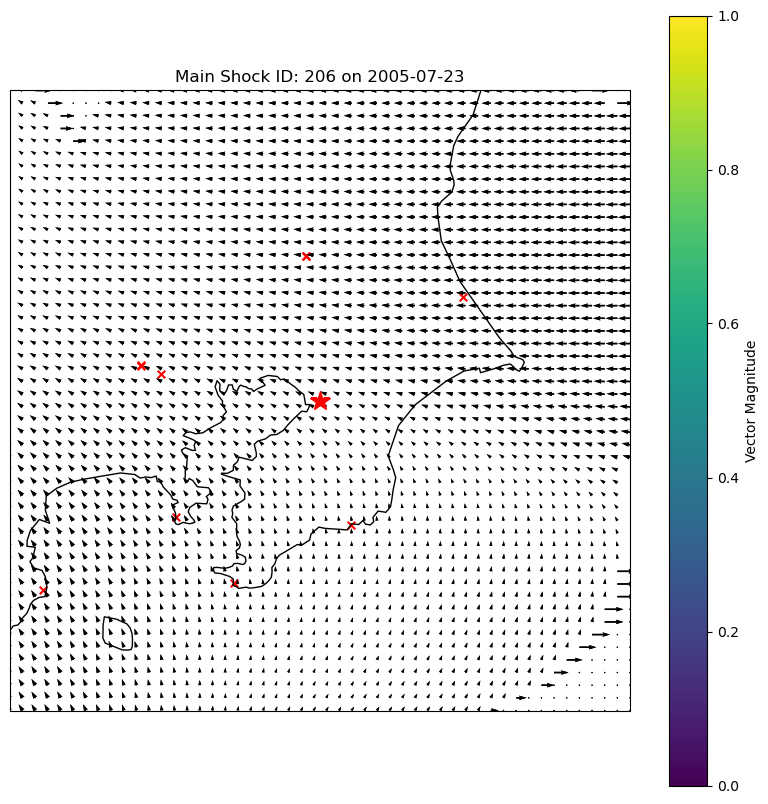

[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0]
[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0]
[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3]


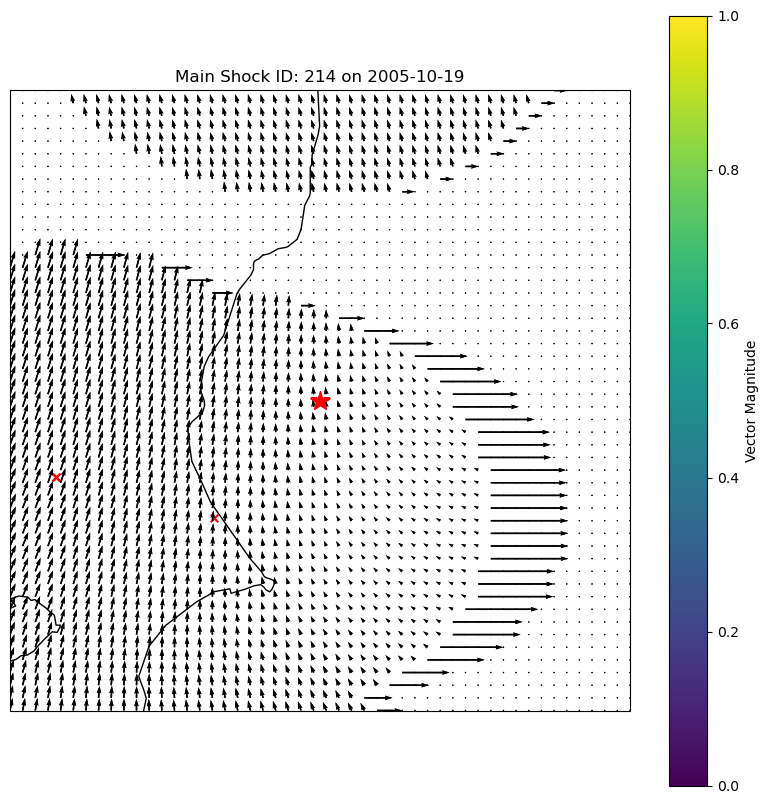

[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3]
[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3]
[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9]


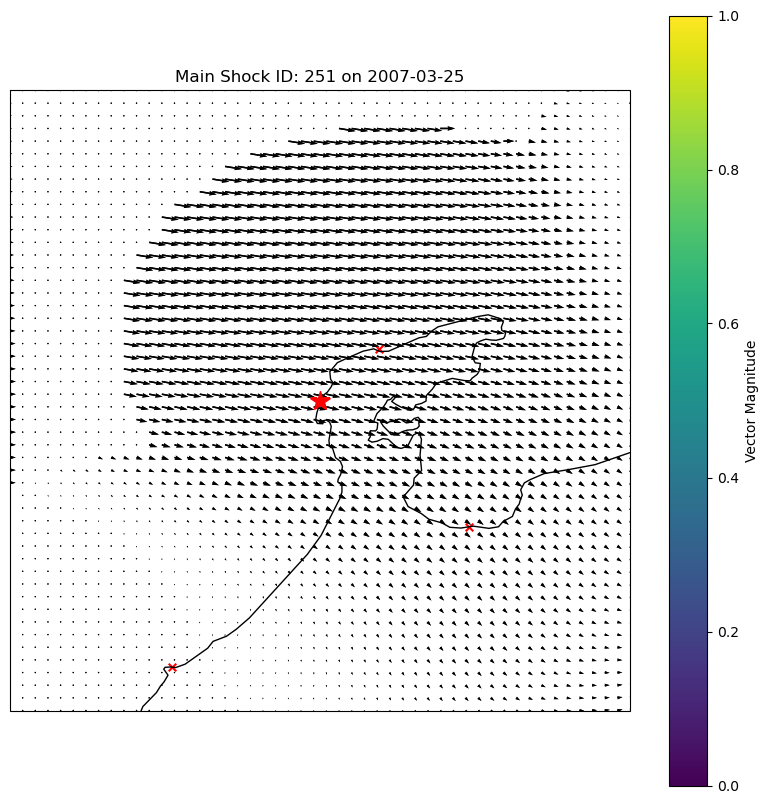

[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9]
[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9]
[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8]


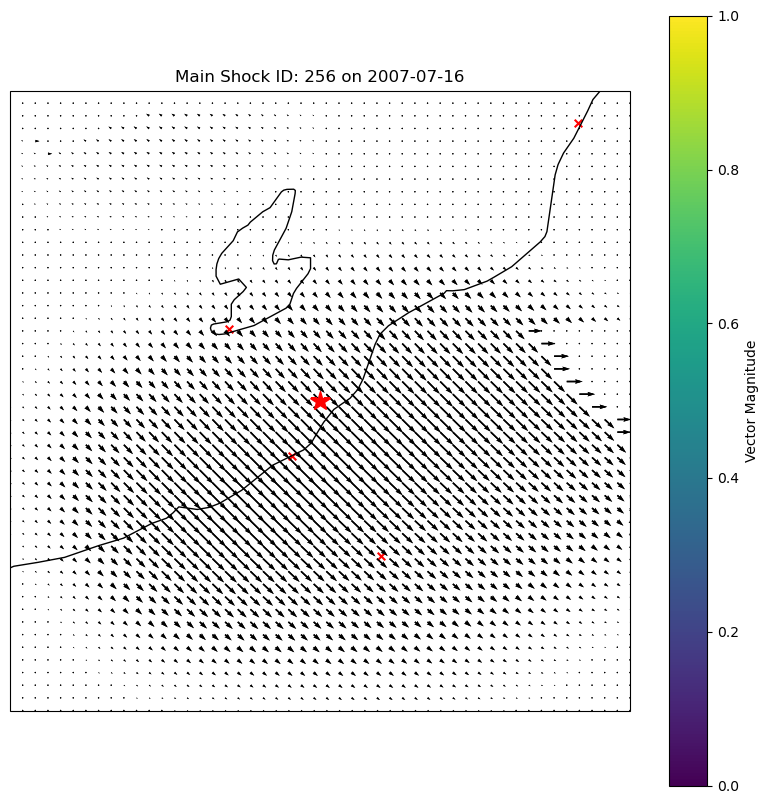

[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8]
[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8]
[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2]


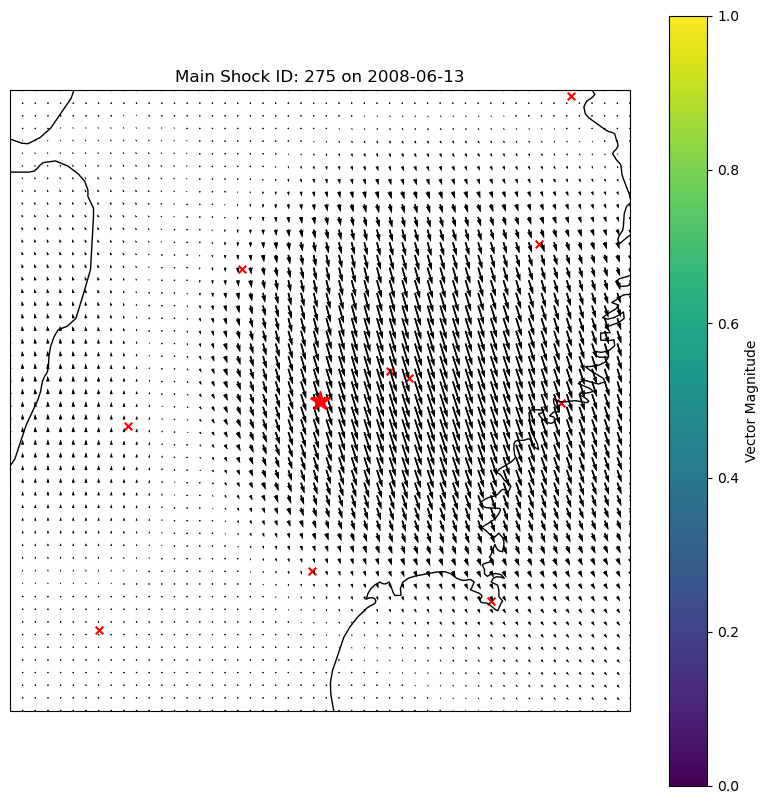

[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2]
[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2]
[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1]


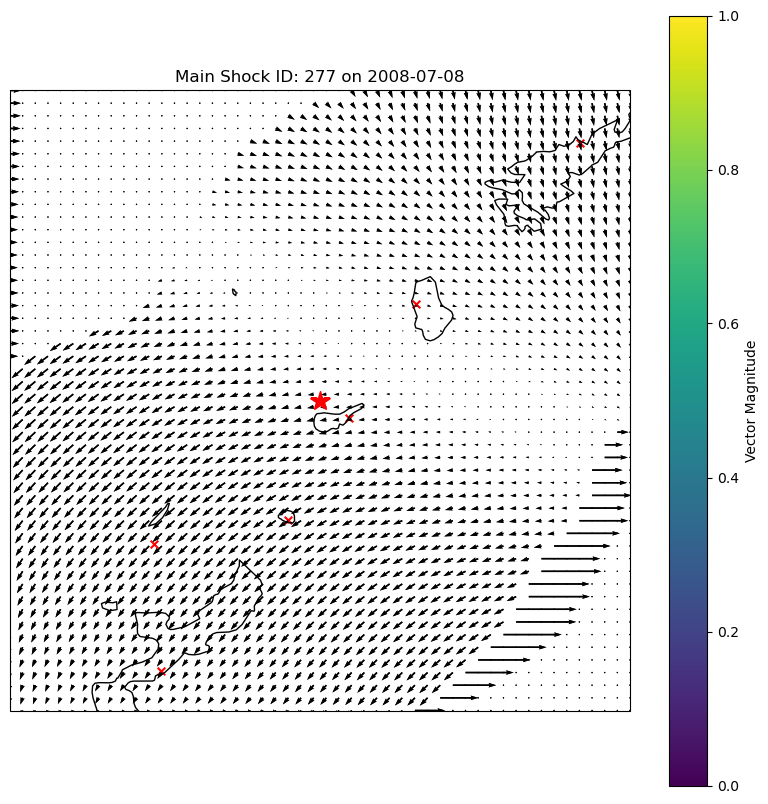

[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1]
[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1]
[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8]


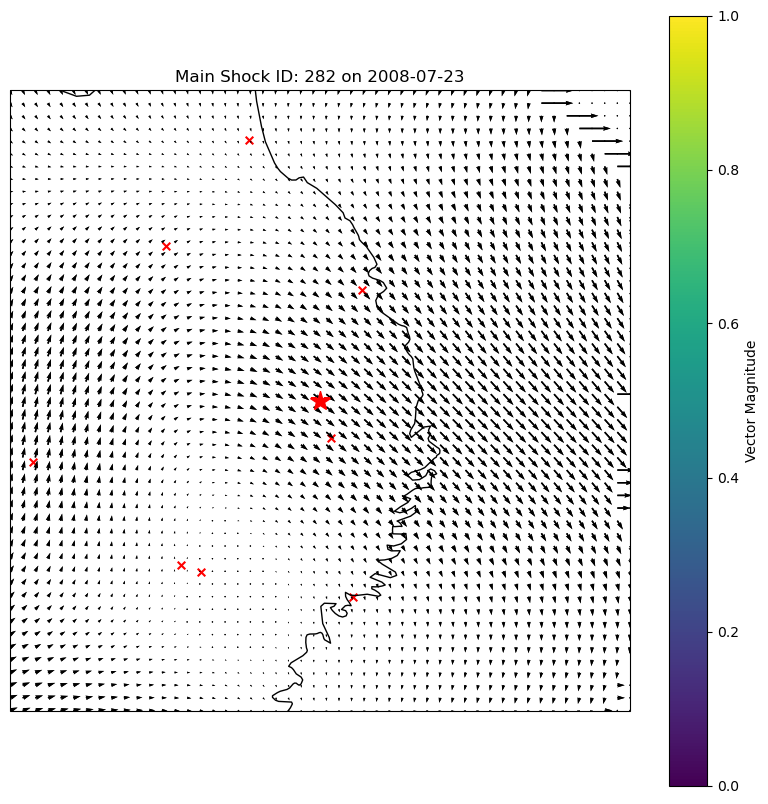

[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8]
[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8]
[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4]


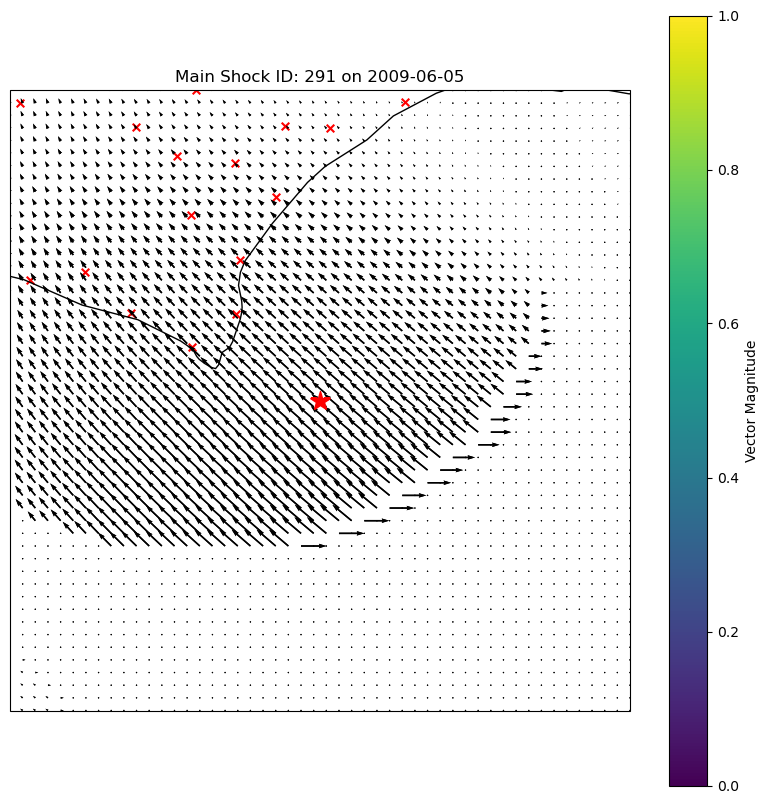

[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4]
[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4]
[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5]


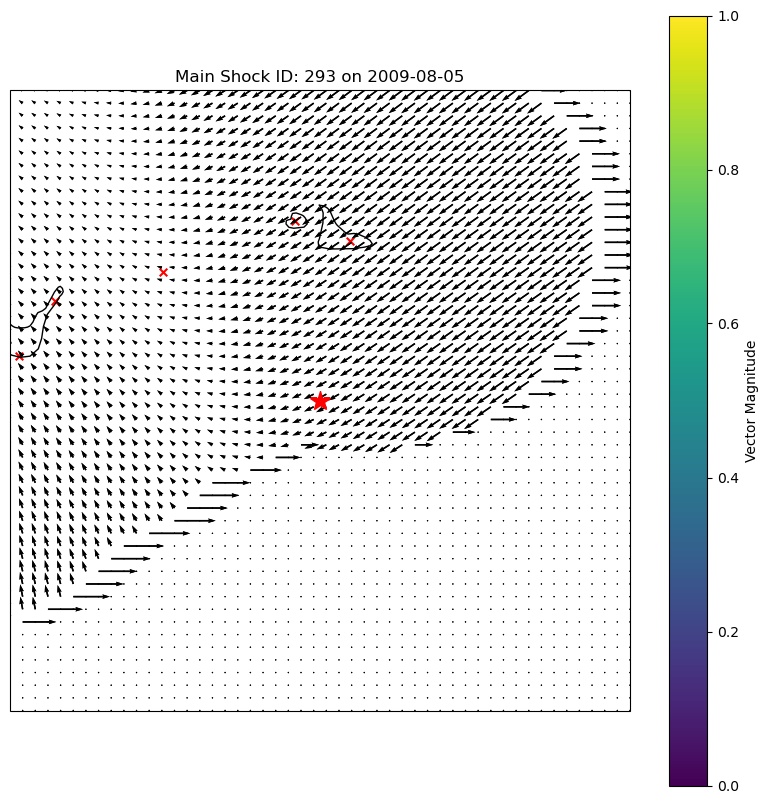

[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5]
[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5]
[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8]


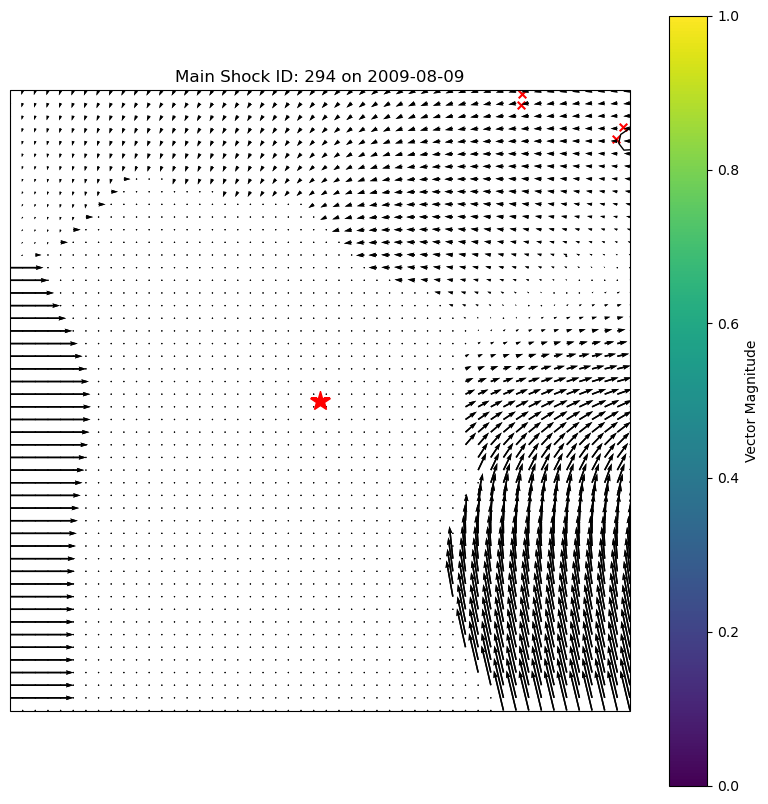

[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8]
[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8]
[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5]


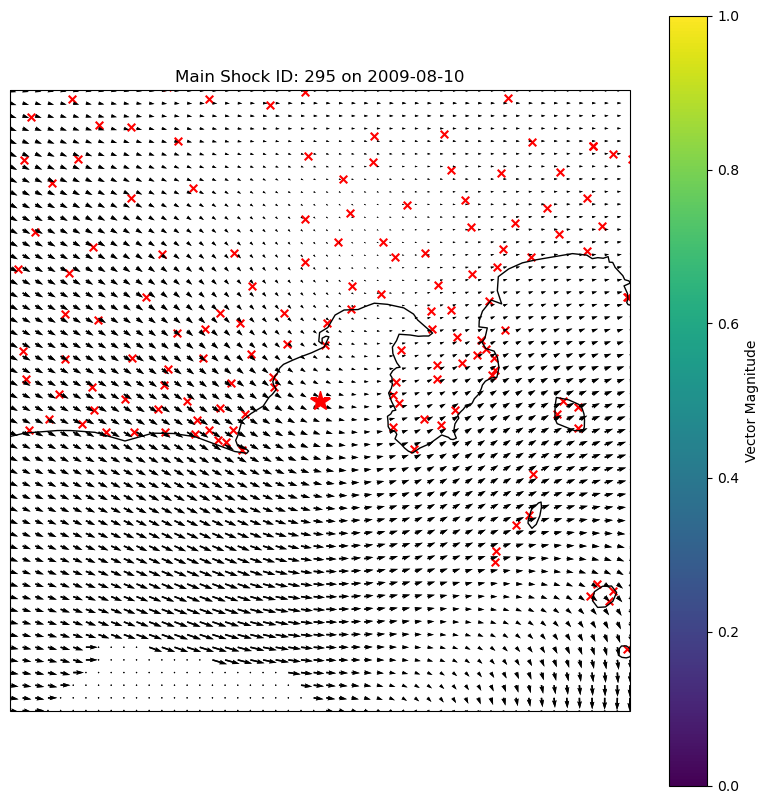

[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5]
[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5]
[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7]


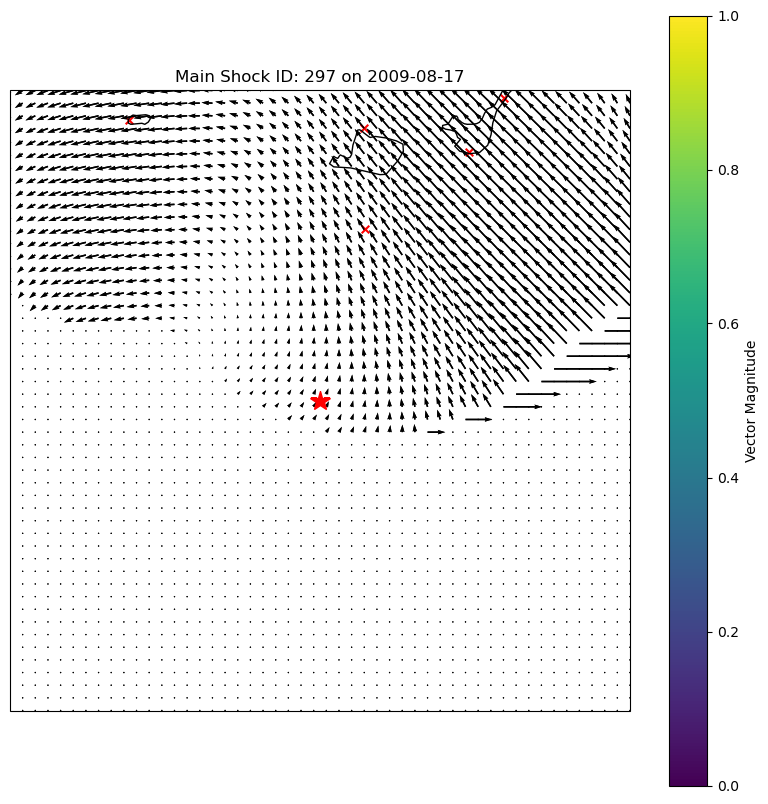

[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7]
[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7]
[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7, 6.0, 6.1]


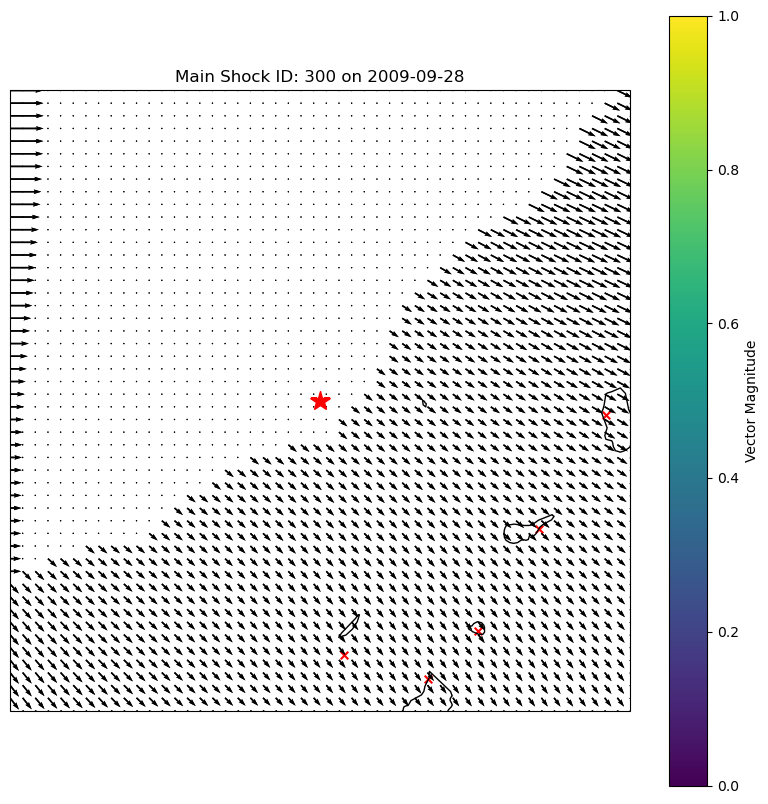

[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7, 6.0, 6.1]
[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7, 6.0, 6.1]
[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7, 6.0, 6.1, 6.8]


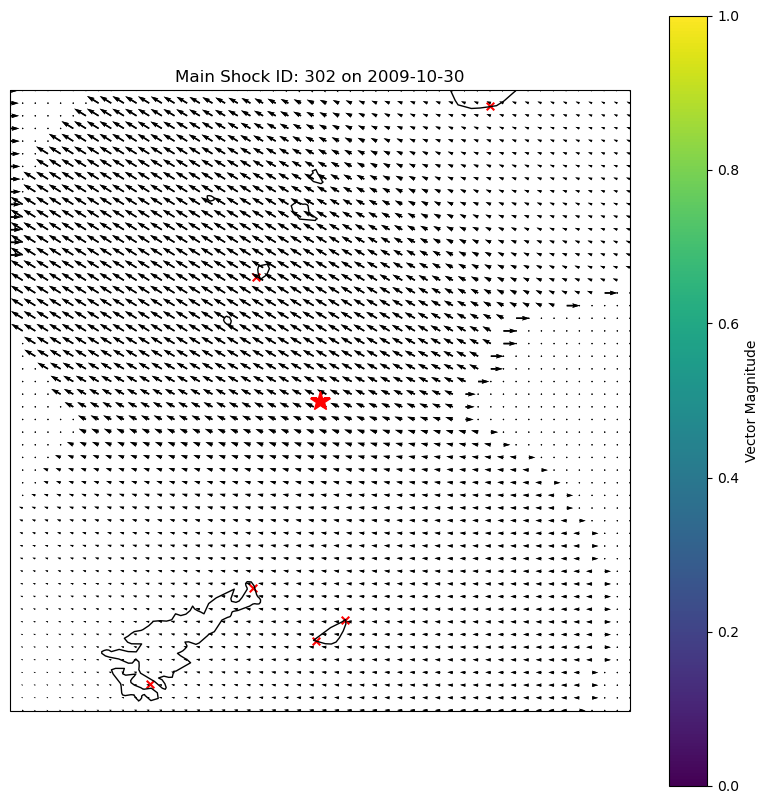

[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7, 6.0, 6.1, 6.8]
[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7, 6.0, 6.1, 6.8]
[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7, 6.0, 6.1, 6.8, 6.5]


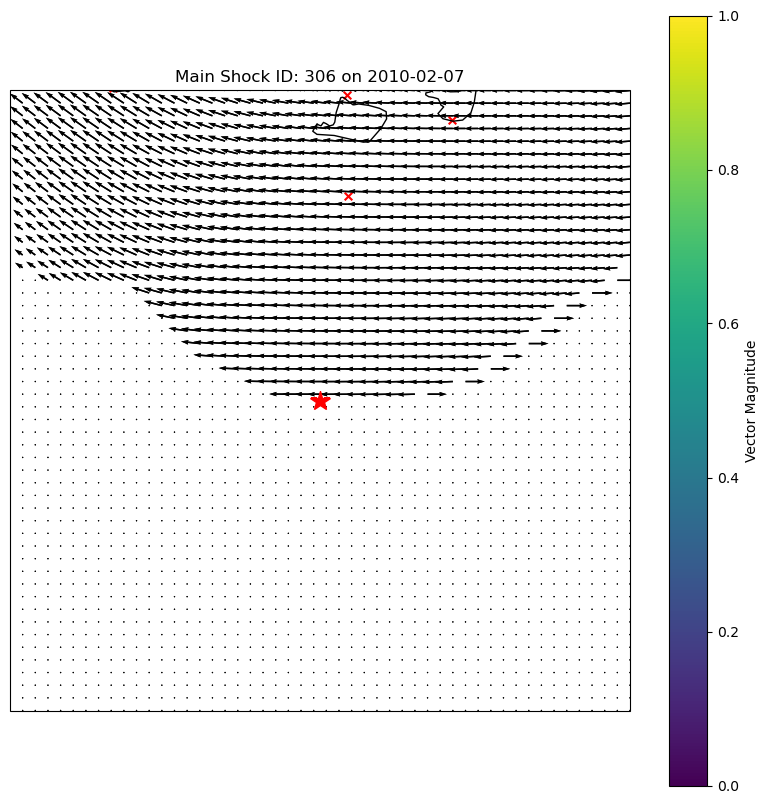

[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7, 6.0, 6.1, 6.8, 6.5]
[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7, 6.0, 6.1, 6.8, 6.5]
[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7, 6.0, 6.1, 6.8, 6.5, 7.2]


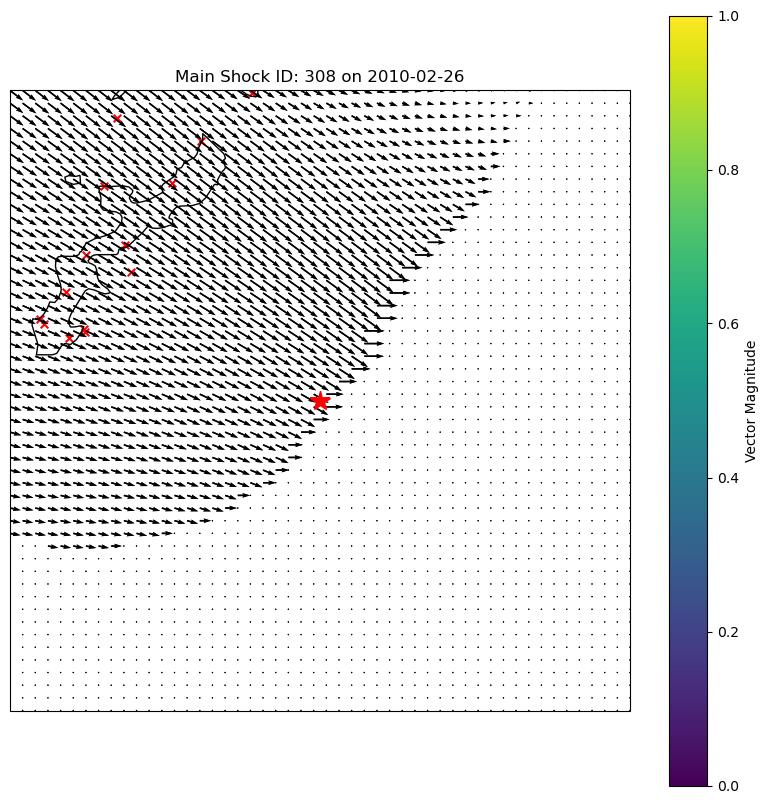

[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7, 6.0, 6.1, 6.8, 6.5, 7.2]
[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7, 6.0, 6.1, 6.8, 6.5, 7.2]
[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7, 6.0, 6.1, 6.8, 6.5, 7.2, 6.7]


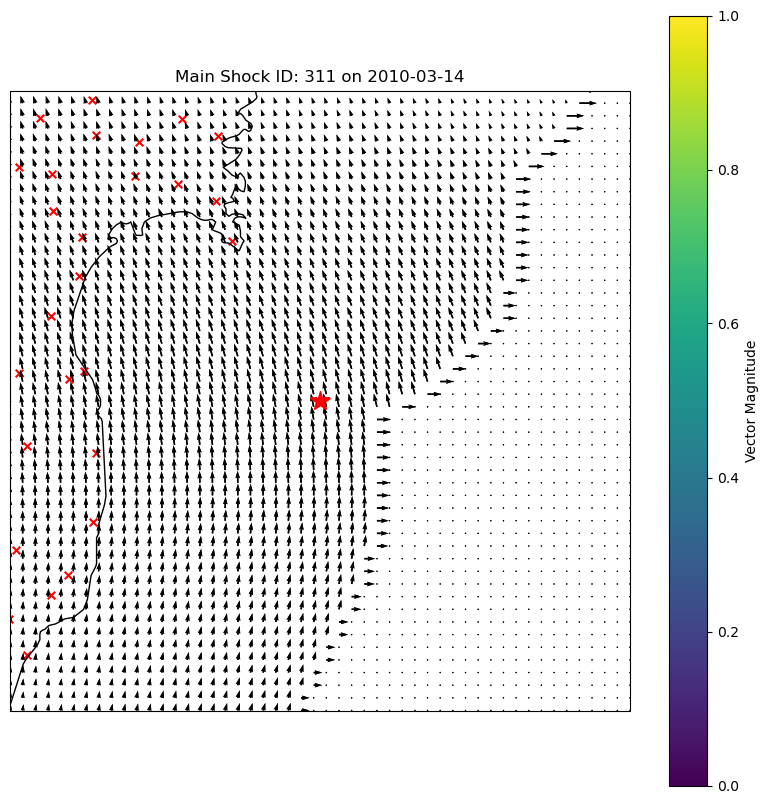

[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7, 6.0, 6.1, 6.8, 6.5, 7.2, 6.7]
[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7, 6.0, 6.1, 6.8, 6.5, 7.2, 6.7]
[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7, 6.0, 6.1, 6.8, 6.5, 7.2, 6.7, 6.6, 6.4, 6.2]


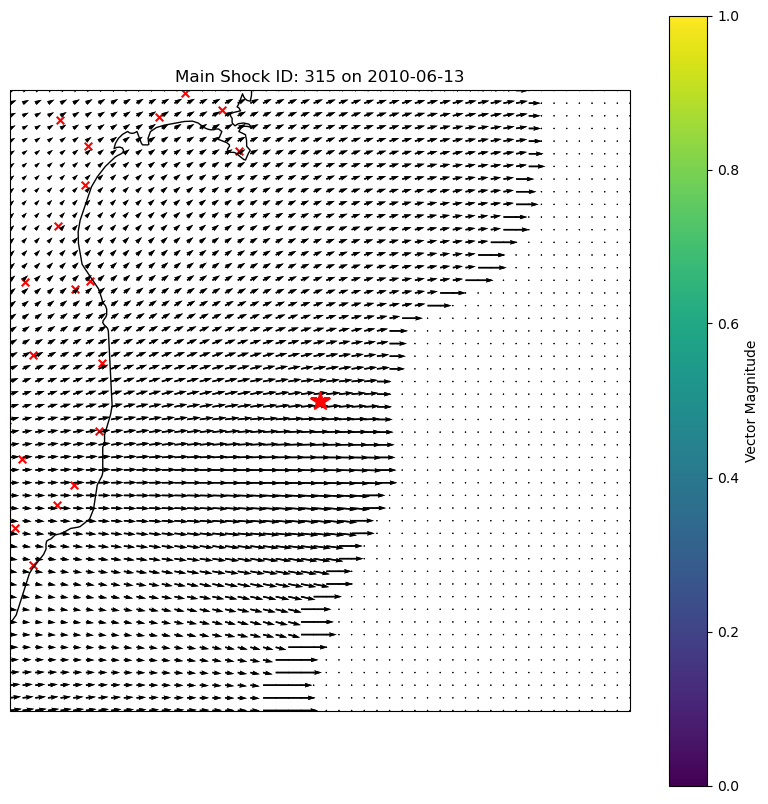

[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7, 6.0, 6.1, 6.8, 6.5, 7.2, 6.7, 6.6, 6.4, 6.2]
[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7, 6.0, 6.1, 6.8, 6.5, 7.2, 6.7, 6.6, 6.4, 6.2]
[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7, 6.0, 6.1, 6.8, 6.5, 7.2, 6.7, 6.6, 6.4, 6.2, 6.4]


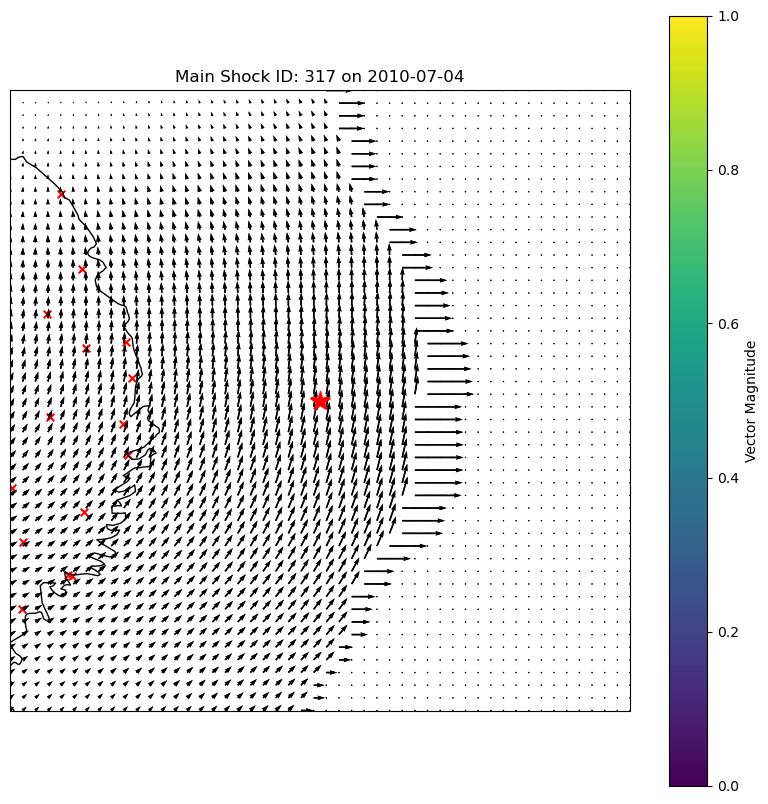

[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7, 6.0, 6.1, 6.8, 6.5, 7.2, 6.7, 6.6, 6.4, 6.2, 6.4]
[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7, 6.0, 6.1, 6.8, 6.5, 7.2, 6.7, 6.6, 6.4, 6.2, 6.4]
[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7, 6.0, 6.1, 6.8, 6.5, 7.2, 6.7, 6.6, 6.4, 6.2, 6.4, 6.3, 6.4]


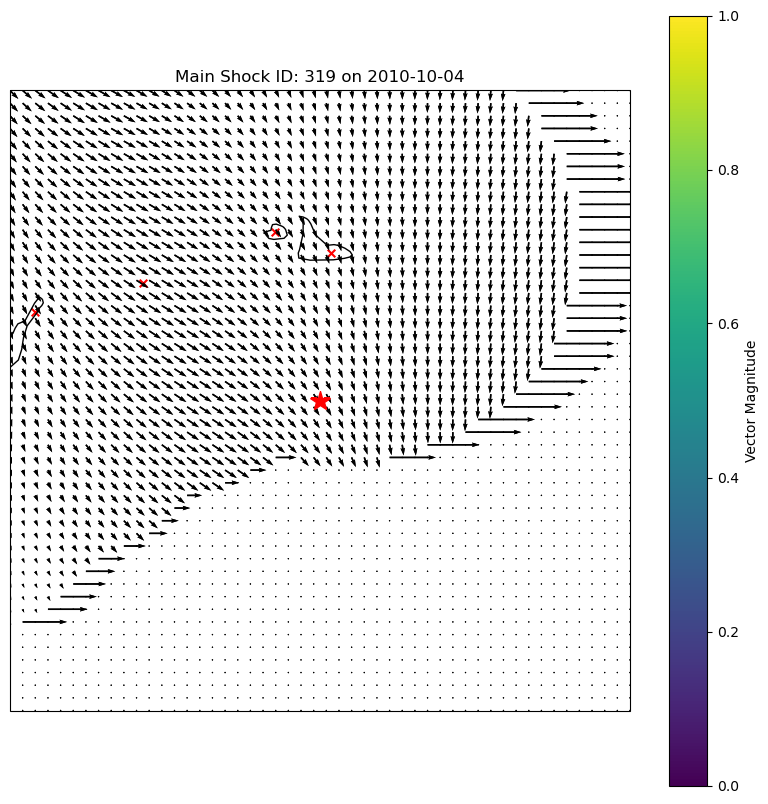

[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7, 6.0, 6.1, 6.8, 6.5, 7.2, 6.7, 6.6, 6.4, 6.2, 6.4, 6.3, 6.4]
[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7, 6.0, 6.1, 6.8, 6.5, 7.2, 6.7, 6.6, 6.4, 6.2, 6.4, 6.3, 6.4]
[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7, 6.0, 6.1, 6.8, 6.5, 7.2, 6.7, 6.6, 6.4, 6.2, 6.4, 6.

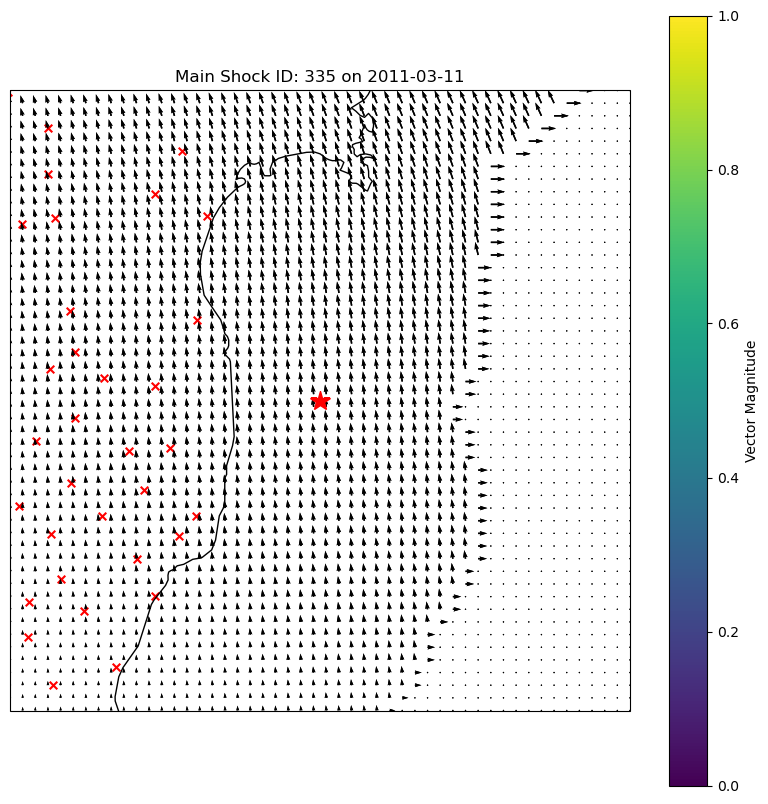

[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7, 6.0, 6.1, 6.8, 6.5, 7.2, 6.7, 6.6, 6.4, 6.2, 6.4, 6.3, 6.4, 7.8, 6.3, 7.3, 6.1]
[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7, 6.0, 6.1, 6.8, 6.5, 7.2, 6.7, 6.6, 6.4, 6.2, 6.4, 6.3, 6.4, 7.8, 6.3, 7.3, 6.1]
[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7, 6.0, 6.1, 6.

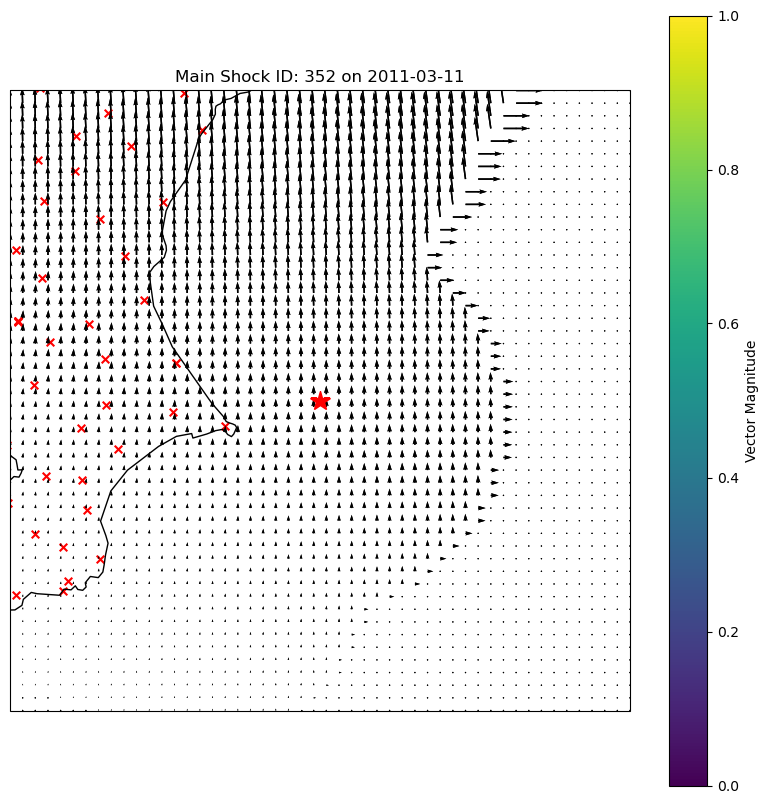

[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7, 6.0, 6.1, 6.8, 6.5, 7.2, 6.7, 6.6, 6.4, 6.2, 6.4, 6.3, 6.4, 7.8, 6.3, 7.3, 6.1, 6.2]
[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7, 6.0, 6.1, 6.8, 6.5, 7.2, 6.7, 6.6, 6.4, 6.2, 6.4, 6.3, 6.4, 7.8, 6.3, 7.3, 6.1, 6.2]
[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7, 6.

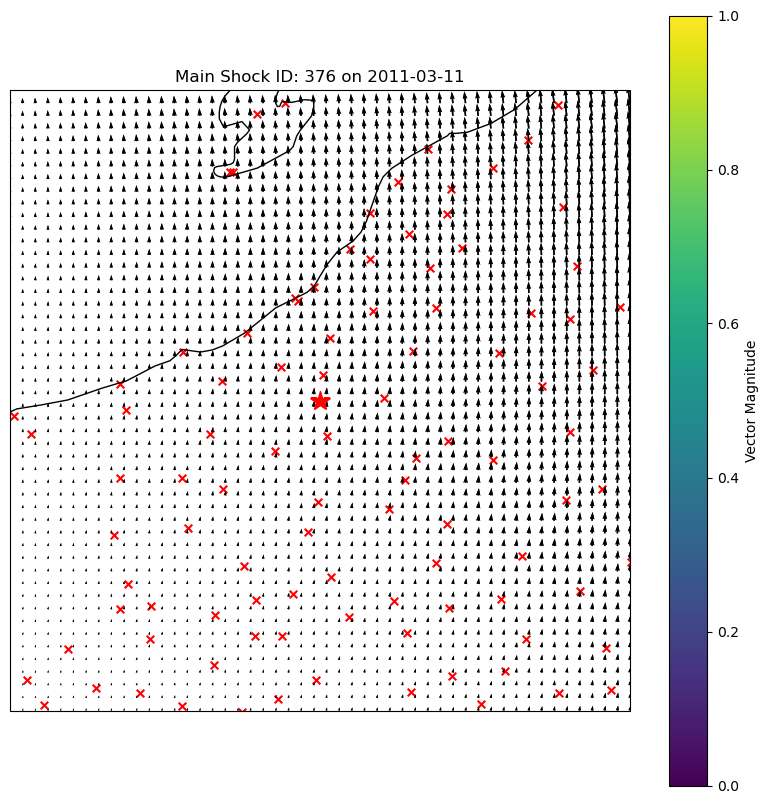

[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7, 6.0, 6.1, 6.8, 6.5, 7.2, 6.7, 6.6, 6.4, 6.2, 6.4, 6.3, 6.4, 7.8, 6.3, 7.3, 6.1, 6.2, 6.7]
[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7, 6.0, 6.1, 6.8, 6.5, 7.2, 6.7, 6.6, 6.4, 6.2, 6.4, 6.3, 6.4, 7.8, 6.3, 7.3, 6.1, 6.2, 6.7]
[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.

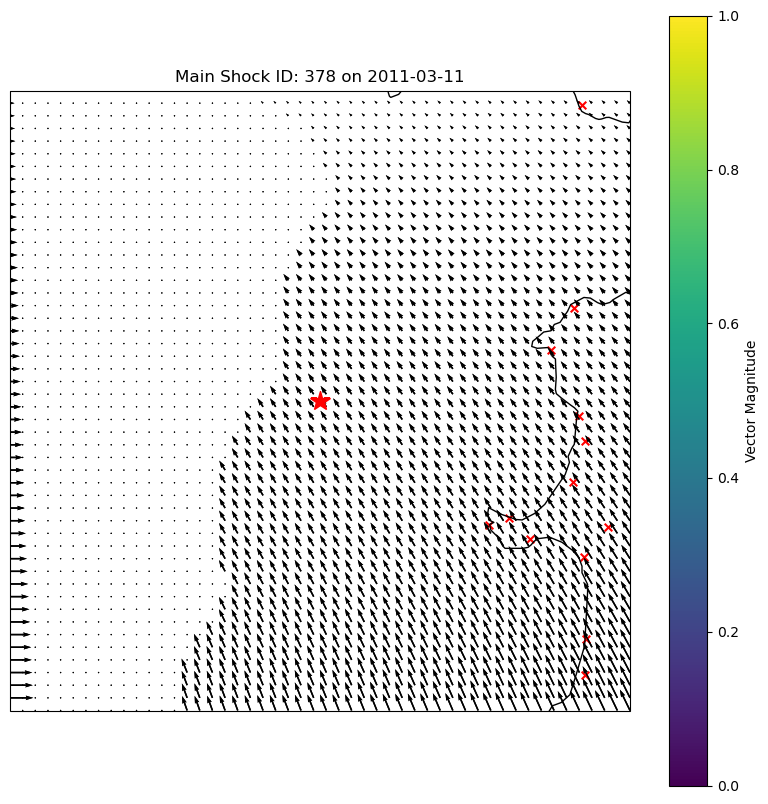

[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7, 6.0, 6.1, 6.8, 6.5, 7.2, 6.7, 6.6, 6.4, 6.2, 6.4, 6.3, 6.4, 7.8, 6.3, 7.3, 6.1, 6.2, 6.7, 6.4]
[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7, 6.0, 6.1, 6.8, 6.5, 7.2, 6.7, 6.6, 6.4, 6.2, 6.4, 6.3, 6.4, 7.8, 6.3, 7.3, 6.1, 6.2, 6.7, 6.4]
[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.

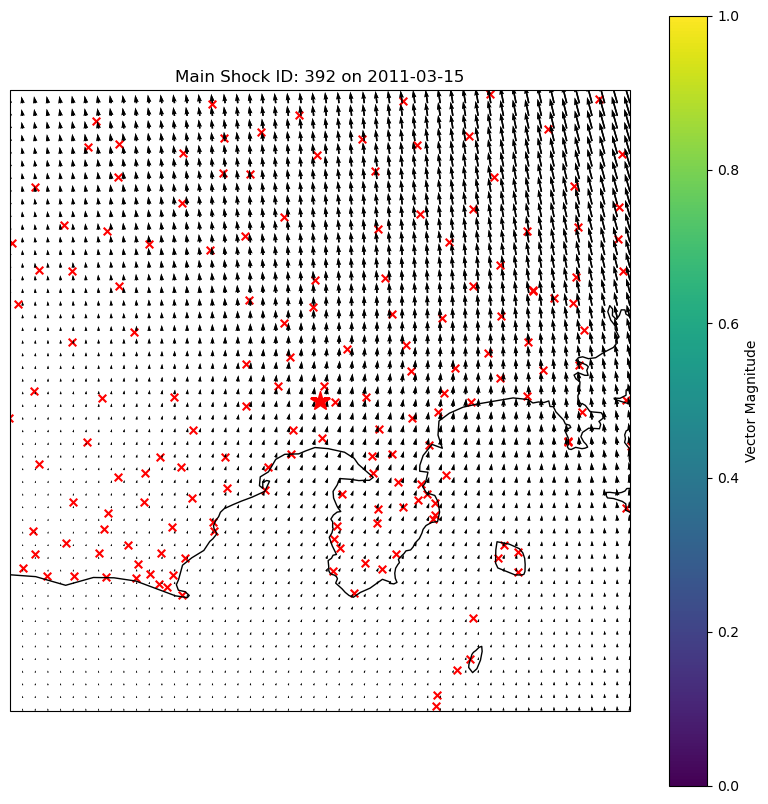

[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7, 6.0, 6.1, 6.8, 6.5, 7.2, 6.7, 6.6, 6.4, 6.2, 6.4, 6.3, 6.4, 7.8, 6.3, 7.3, 6.1, 6.2, 6.7, 6.4, 6.4]
[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7, 6.0, 6.1, 6.8, 6.5, 7.2, 6.7, 6.6, 6.4, 6.2, 6.4, 6.3, 6.4, 7.8, 6.3, 7.3, 6.1, 6.2, 6.7, 6.4, 6.4]
[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.

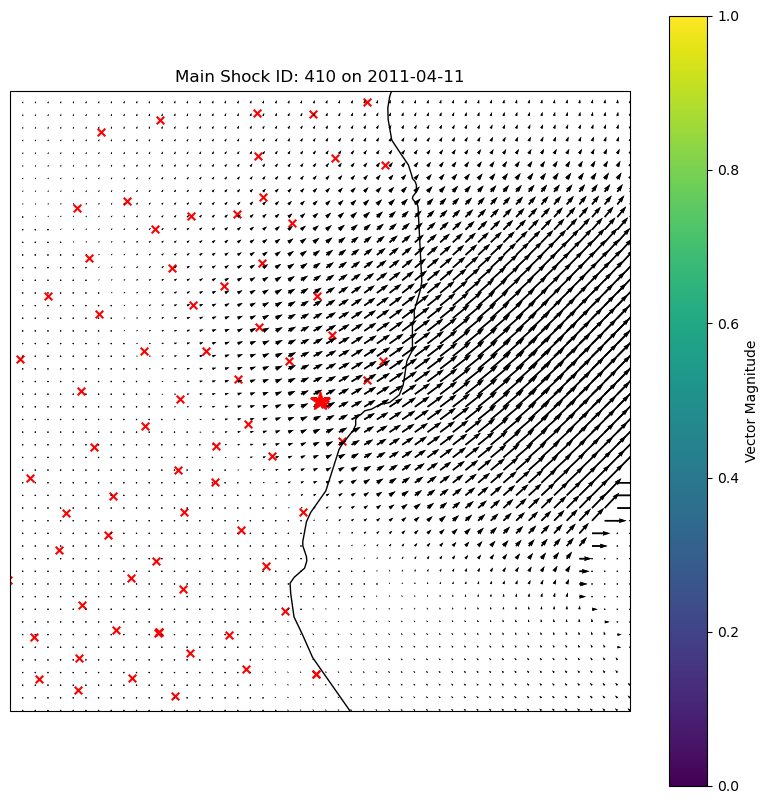

[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7, 6.0, 6.1, 6.8, 6.5, 7.2, 6.7, 6.6, 6.4, 6.2, 6.4, 6.3, 6.4, 7.8, 6.3, 7.3, 6.1, 6.2, 6.7, 6.4, 6.4, 6.3, 7.0]
[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7, 6.0, 6.1, 6.8, 6.5, 7.2, 6.7, 6.6, 6.4, 6.2, 6.4, 6.3, 6.4, 7.8, 6.3, 7.3, 6.1, 6.2, 6.7, 6.4, 6.4, 6.3, 7.0]
[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.

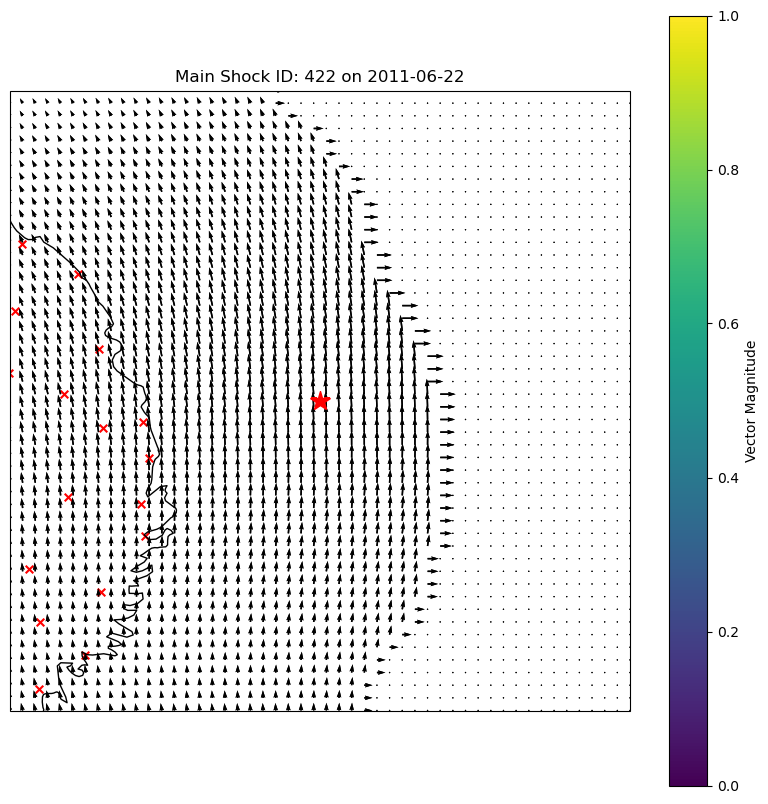

[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7, 6.0, 6.1, 6.8, 6.5, 7.2, 6.7, 6.6, 6.4, 6.2, 6.4, 6.3, 6.4, 7.8, 6.3, 7.3, 6.1, 6.2, 6.7, 6.4, 6.4, 6.3, 7.0, 6.0, 6.0, 6.1, 6.0, 6.9]
[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7, 6.0, 6.1, 6.8, 6.5, 7.2, 6.7, 6.6, 6.4, 6.2, 6.4, 6.3, 6.4, 7.8, 6.3, 7.3, 6.1, 6.2, 6.7, 6.4, 6.4, 6.3, 7.0, 6.0, 6.0, 6.1, 6.0, 6.9]
[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.

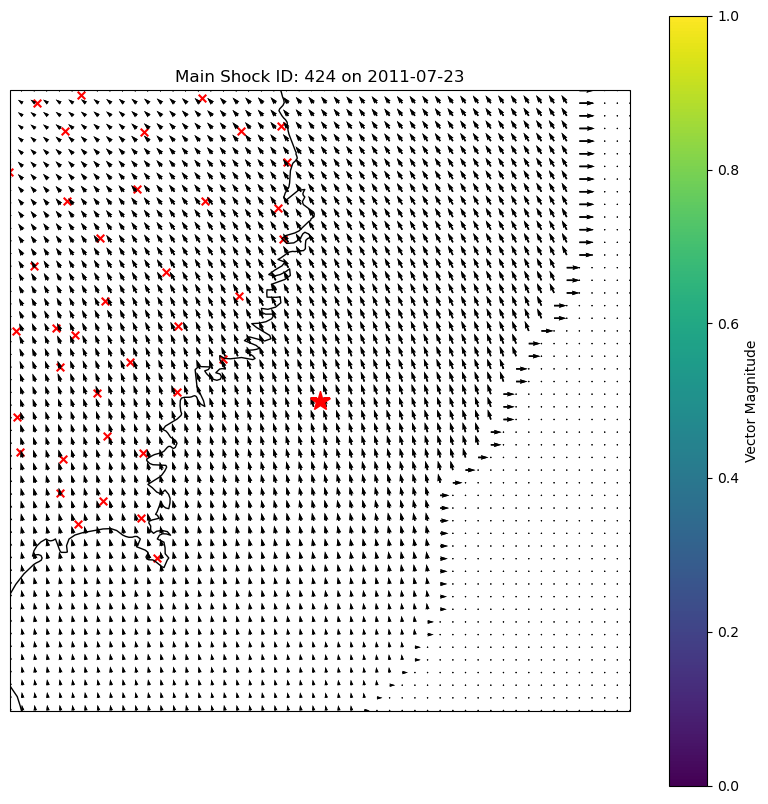

[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7, 6.0, 6.1, 6.8, 6.5, 7.2, 6.7, 6.6, 6.4, 6.2, 6.4, 6.3, 6.4, 7.8, 6.3, 7.3, 6.1, 6.2, 6.7, 6.4, 6.4, 6.3, 7.0, 6.0, 6.0, 6.1, 6.0, 6.9, 6.4]
[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7, 6.0, 6.1, 6.8, 6.5, 7.2, 6.7, 6.6, 6.4, 6.2, 6.4, 6.3, 6.4, 7.8, 6.3, 7.3, 6.1, 6.2, 6.7, 6.4, 6.4, 6.3, 7.0, 6.0, 6.0, 6.1, 6.0, 6.9, 6.4]
[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.

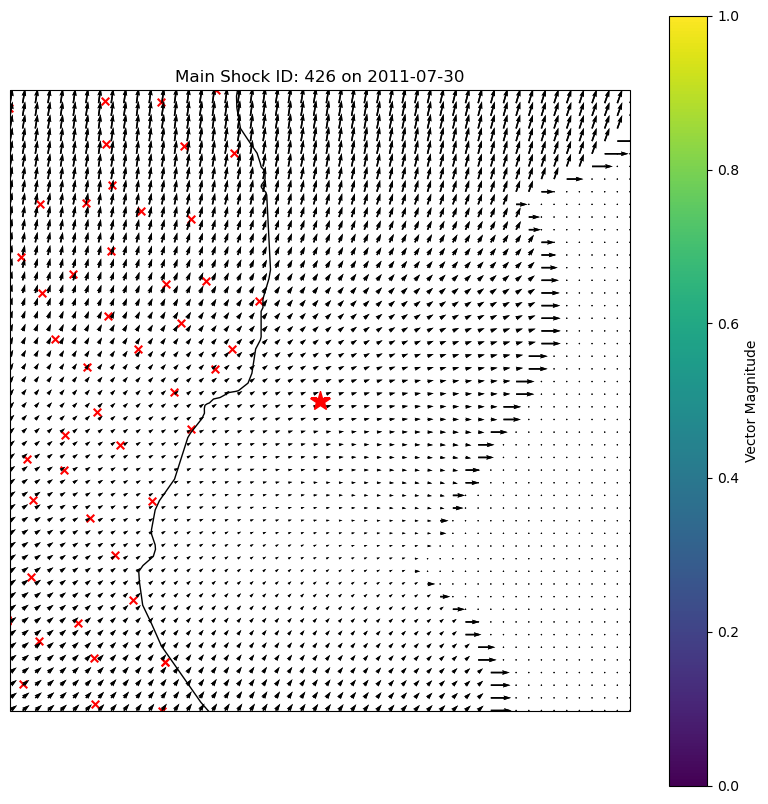

[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7, 6.0, 6.1, 6.8, 6.5, 7.2, 6.7, 6.6, 6.4, 6.2, 6.4, 6.3, 6.4, 7.8, 6.3, 7.3, 6.1, 6.2, 6.7, 6.4, 6.4, 6.3, 7.0, 6.0, 6.0, 6.1, 6.0, 6.9, 6.4, 6.5]
[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7, 6.0, 6.1, 6.8, 6.5, 7.2, 6.7, 6.6, 6.4, 6.2, 6.4, 6.3, 6.4, 7.8, 6.3, 7.3, 6.1, 6.2, 6.7, 6.4, 6.4, 6.3, 7.0, 6.0, 6.0, 6.1, 6.0, 6.9, 6.4, 6.5]
[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.

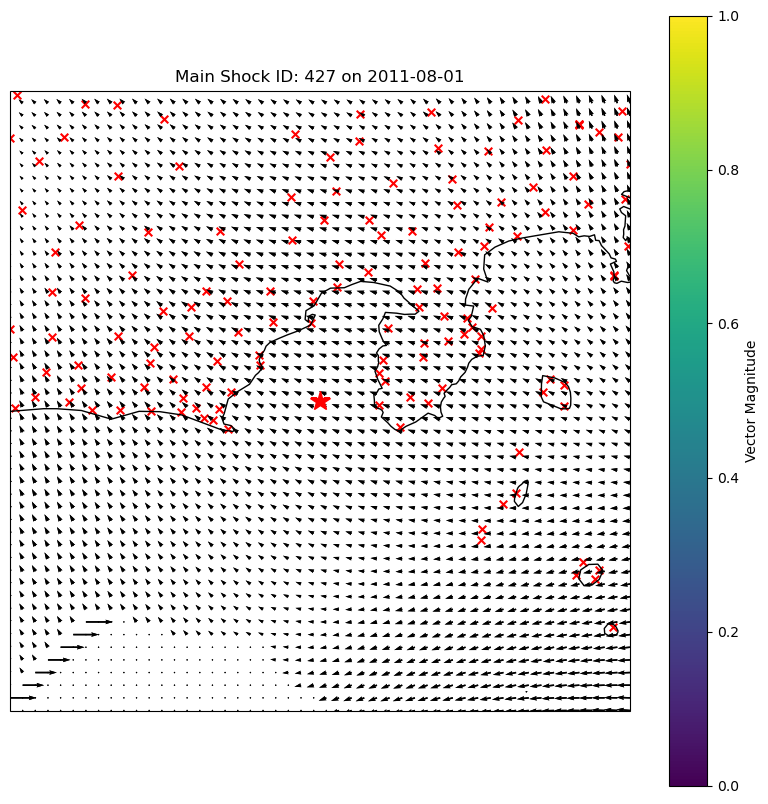

[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7, 6.0, 6.1, 6.8, 6.5, 7.2, 6.7, 6.6, 6.4, 6.2, 6.4, 6.3, 6.4, 7.8, 6.3, 7.3, 6.1, 6.2, 6.7, 6.4, 6.4, 6.3, 7.0, 6.0, 6.0, 6.1, 6.0, 6.9, 6.4, 6.5, 6.2]
[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7, 6.0, 6.1, 6.8, 6.5, 7.2, 6.7, 6.6, 6.4, 6.2, 6.4, 6.3, 6.4, 7.8, 6.3, 7.3, 6.1, 6.2, 6.7, 6.4, 6.4, 6.3, 7.0, 6.0, 6.0, 6.1, 6.0, 6.9, 6.4, 6.5, 6.2]
[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.

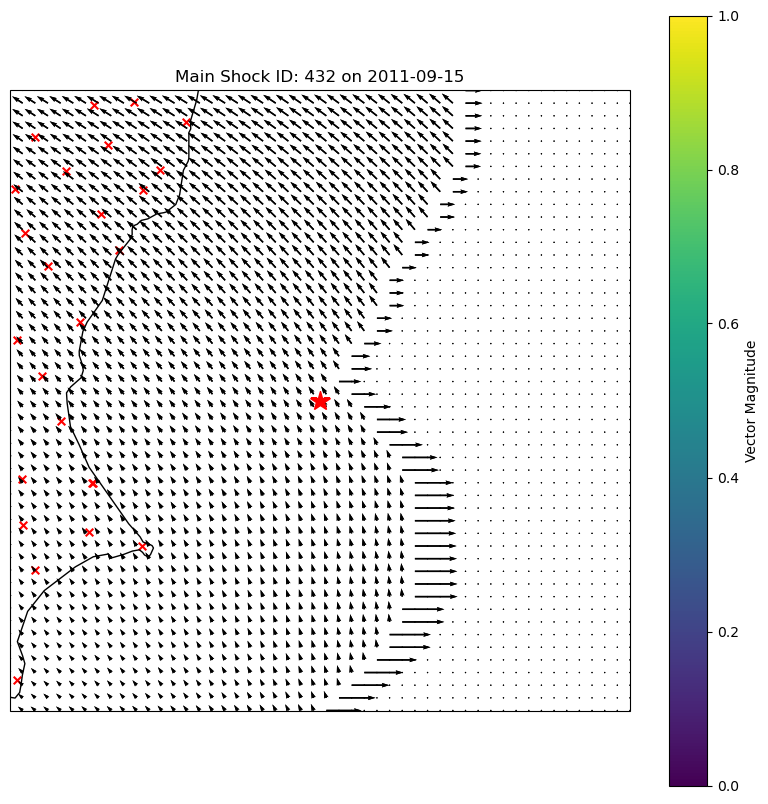

[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7, 6.0, 6.1, 6.8, 6.5, 7.2, 6.7, 6.6, 6.4, 6.2, 6.4, 6.3, 6.4, 7.8, 6.3, 7.3, 6.1, 6.2, 6.7, 6.4, 6.4, 6.3, 7.0, 6.0, 6.0, 6.1, 6.0, 6.9, 6.4, 6.5, 6.2, 6.2, 6.3]
[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7, 6.0, 6.1, 6.8, 6.5, 7.2, 6.7, 6.6, 6.4, 6.2, 6.4, 6.3, 6.4, 7.8, 6.3, 7.3, 6.1, 6.2, 6.7, 6.4, 6.4, 6.3, 7.0, 6.0, 6.0, 6.1, 6.0, 6.9, 6.4, 6.5, 6.2, 6.2, 6.3]
[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.

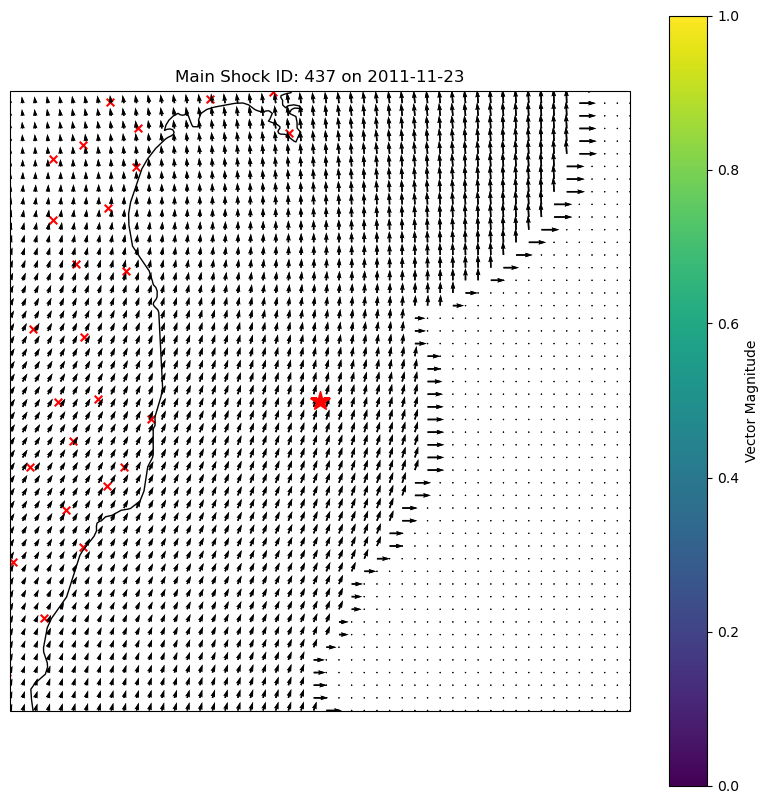

[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7, 6.0, 6.1, 6.8, 6.5, 7.2, 6.7, 6.6, 6.4, 6.2, 6.4, 6.3, 6.4, 7.8, 6.3, 7.3, 6.1, 6.2, 6.7, 6.4, 6.4, 6.3, 7.0, 6.0, 6.0, 6.1, 6.0, 6.9, 6.4, 6.5, 6.2, 6.2, 6.3, 6.6, 7.0, 6.1]
[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7, 6.0, 6.1, 6.8, 6.5, 7.2, 6.7, 6.6, 6.4, 6.2, 6.4, 6.3, 6.4, 7.8, 6.3, 7.3, 6.1, 6.2, 6.7, 6.4, 6.4, 6.3, 7.0, 6.0, 6.0, 6.1, 6.0, 6.9, 6.4, 6.5, 6.2, 6.2, 6.3, 6.6, 7.0, 6.1]
[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.

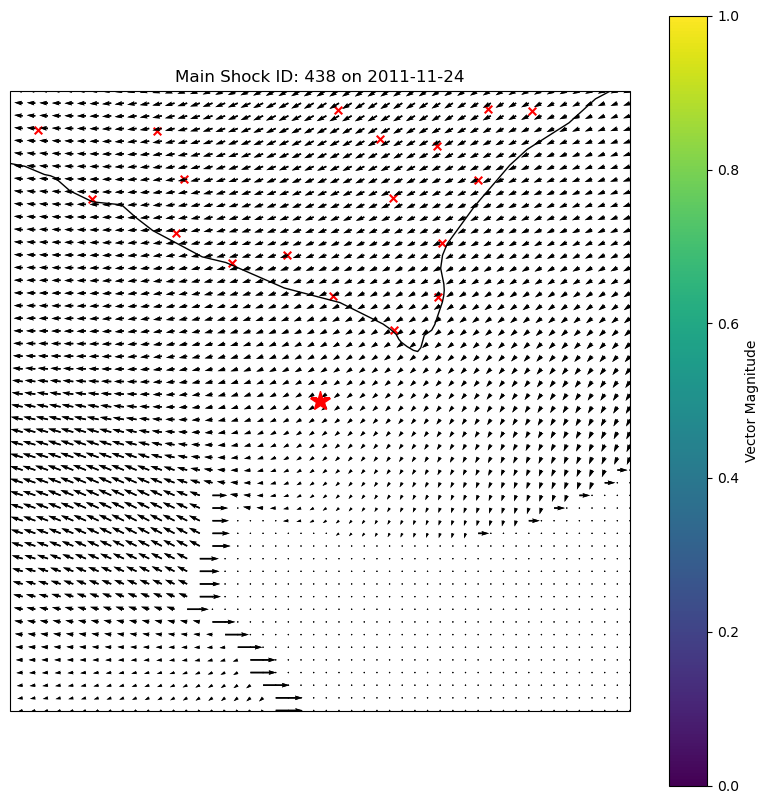

[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7, 6.0, 6.1, 6.8, 6.5, 7.2, 6.7, 6.6, 6.4, 6.2, 6.4, 6.3, 6.4, 7.8, 6.3, 7.3, 6.1, 6.2, 6.7, 6.4, 6.4, 6.3, 7.0, 6.0, 6.0, 6.1, 6.0, 6.9, 6.4, 6.5, 6.2, 6.2, 6.3, 6.6, 7.0, 6.1, 6.2]
[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7, 6.0, 6.1, 6.8, 6.5, 7.2, 6.7, 6.6, 6.4, 6.2, 6.4, 6.3, 6.4, 7.8, 6.3, 7.3, 6.1, 6.2, 6.7, 6.4, 6.4, 6.3, 7.0, 6.0, 6.0, 6.1, 6.0, 6.9, 6.4, 6.5, 6.2, 6.2, 6.3, 6.6, 7.0, 6.1, 6.2]
[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.

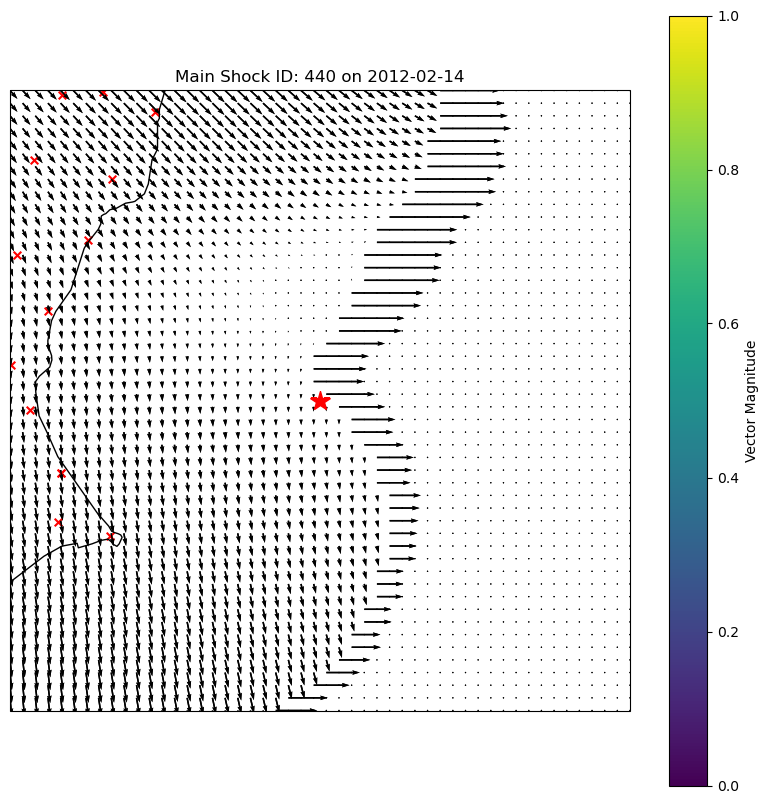

[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7, 6.0, 6.1, 6.8, 6.5, 7.2, 6.7, 6.6, 6.4, 6.2, 6.4, 6.3, 6.4, 7.8, 6.3, 7.3, 6.1, 6.2, 6.7, 6.4, 6.4, 6.3, 7.0, 6.0, 6.0, 6.1, 6.0, 6.9, 6.4, 6.5, 6.2, 6.2, 6.3, 6.6, 7.0, 6.1, 6.2, 7.0, 6.0]
[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7, 6.0, 6.1, 6.8, 6.5, 7.2, 6.7, 6.6, 6.4, 6.2, 6.4, 6.3, 6.4, 7.8, 6.3, 7.3, 6.1, 6.2, 6.7, 6.4, 6.4, 6.3, 7.0, 6.0, 6.0, 6.1, 6.0, 6.9, 6.4, 6.5, 6.2, 6.2, 6.3, 6.6, 7.0, 6.1, 6.2, 7.0, 6.0]
[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.

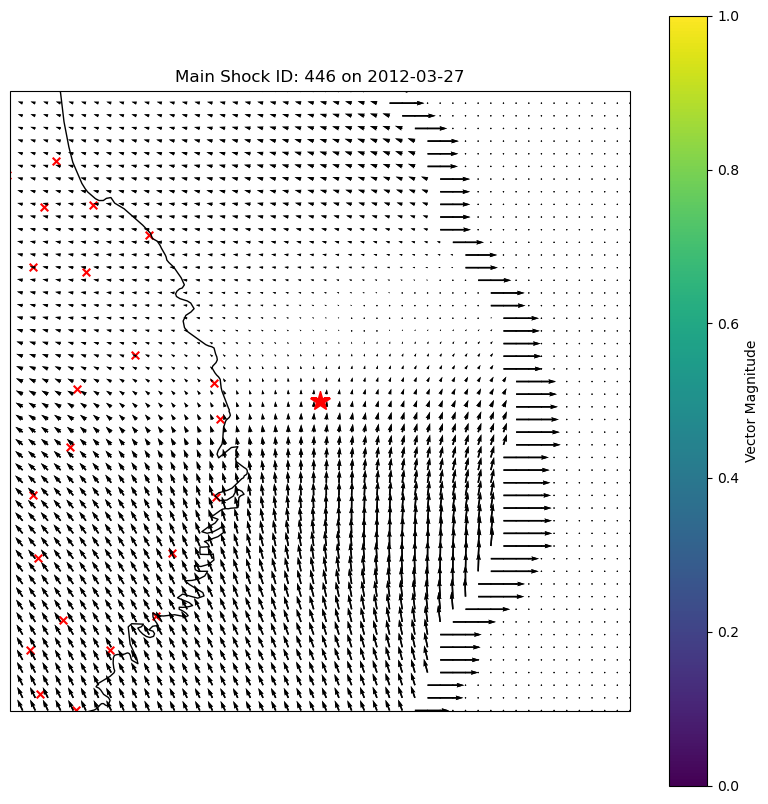

[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7, 6.0, 6.1, 6.8, 6.5, 7.2, 6.7, 6.6, 6.4, 6.2, 6.4, 6.3, 6.4, 7.8, 6.3, 7.3, 6.1, 6.2, 6.7, 6.4, 6.4, 6.3, 7.0, 6.0, 6.0, 6.1, 6.0, 6.9, 6.4, 6.5, 6.2, 6.2, 6.3, 6.6, 7.0, 6.1, 6.2, 7.0, 6.0, 6.0, 6.9, 6.6]
[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7, 6.0, 6.1, 6.8, 6.5, 7.2, 6.7, 6.6, 6.4, 6.2, 6.4, 6.3, 6.4, 7.8, 6.3, 7.3, 6.1, 6.2, 6.7, 6.4, 6.4, 6.3, 7.0, 6.0, 6.0, 6.1, 6.0, 6.9, 6.4, 6.5, 6.2, 6.2, 6.3, 6.6, 7.0, 6.1, 6.2, 7.0, 6.0, 6.0, 6.9, 6.6]
[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.

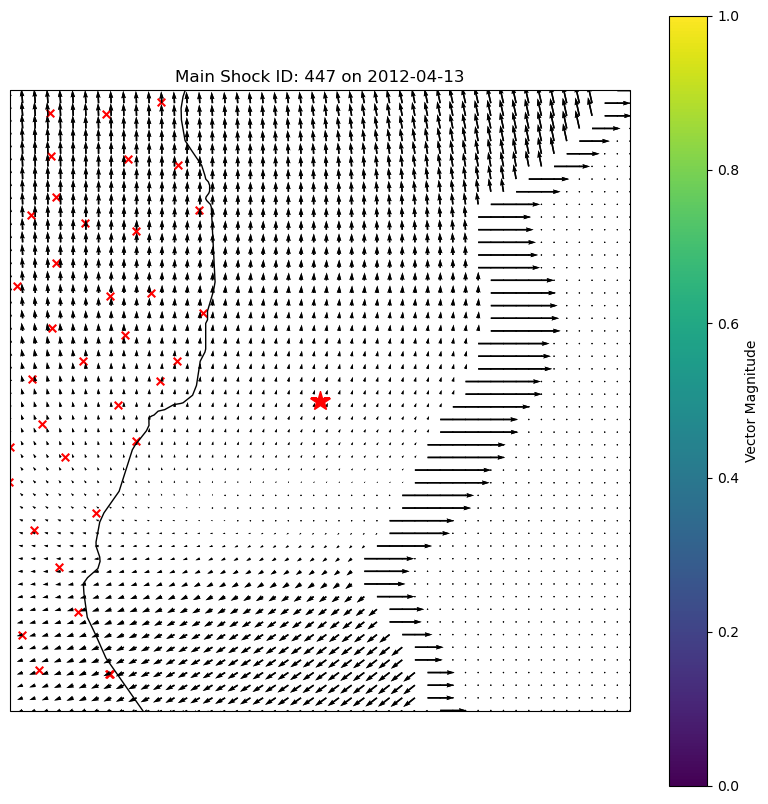

[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7, 6.0, 6.1, 6.8, 6.5, 7.2, 6.7, 6.6, 6.4, 6.2, 6.4, 6.3, 6.4, 7.8, 6.3, 7.3, 6.1, 6.2, 6.7, 6.4, 6.4, 6.3, 7.0, 6.0, 6.0, 6.1, 6.0, 6.9, 6.4, 6.5, 6.2, 6.2, 6.3, 6.6, 7.0, 6.1, 6.2, 7.0, 6.0, 6.0, 6.9, 6.6, 6.0]
[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7, 6.0, 6.1, 6.8, 6.5, 7.2, 6.7, 6.6, 6.4, 6.2, 6.4, 6.3, 6.4, 7.8, 6.3, 7.3, 6.1, 6.2, 6.7, 6.4, 6.4, 6.3, 7.0, 6.0, 6.0, 6.1, 6.0, 6.9, 6.4, 6.5, 6.2, 6.2, 6.3, 6.6, 7.0, 6.1, 6.2, 7.0, 6.0, 6.0, 6.9, 6.6, 6.0]
[6.1, 6.5, 6.4, 6.1, 6.1, 6.

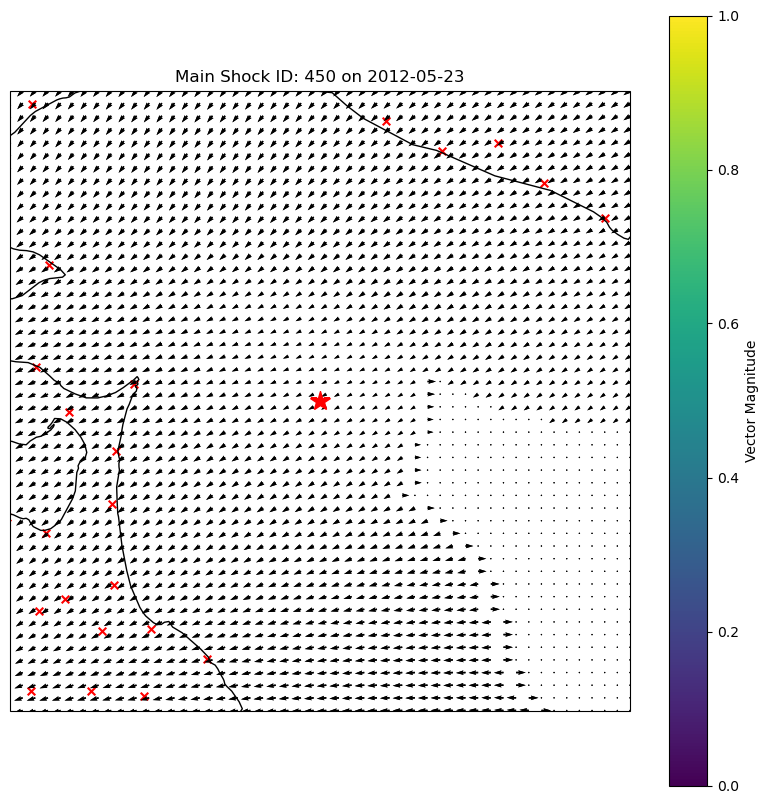

[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7, 6.0, 6.1, 6.8, 6.5, 7.2, 6.7, 6.6, 6.4, 6.2, 6.4, 6.3, 6.4, 7.8, 6.3, 7.3, 6.1, 6.2, 6.7, 6.4, 6.4, 6.3, 7.0, 6.0, 6.0, 6.1, 6.0, 6.9, 6.4, 6.5, 6.2, 6.2, 6.3, 6.6, 7.0, 6.1, 6.2, 7.0, 6.0, 6.0, 6.9, 6.6, 6.0, 6.0, 6.1]
[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7, 6.0, 6.1, 6.8, 6.5, 7.2, 6.7, 6.6, 6.4, 6.2, 6.4, 6.3, 6.4, 7.8, 6.3, 7.3, 6.1, 6.2, 6.7, 6.4, 6.4, 6.3, 7.0, 6.0, 6.0, 6.1, 6.0, 6.9, 6.4, 6.5, 6.2, 6.2, 6.3, 6.6, 7.0, 6.1, 6.2, 7.0, 6.0, 6.0, 6.9, 6.6, 6.0, 6.0, 6.1]
[6.1, 6.

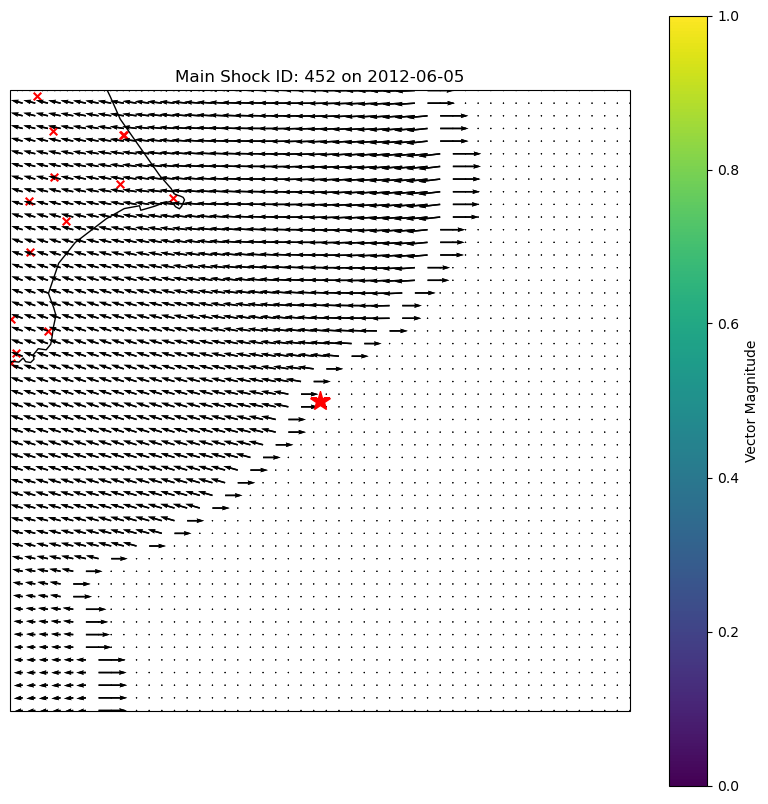

[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7, 6.0, 6.1, 6.8, 6.5, 7.2, 6.7, 6.6, 6.4, 6.2, 6.4, 6.3, 6.4, 7.8, 6.3, 7.3, 6.1, 6.2, 6.7, 6.4, 6.4, 6.3, 7.0, 6.0, 6.0, 6.1, 6.0, 6.9, 6.4, 6.5, 6.2, 6.2, 6.3, 6.6, 7.0, 6.1, 6.2, 7.0, 6.0, 6.0, 6.9, 6.6, 6.0, 6.0, 6.1, 6.0, 6.3]
[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7, 6.0, 6.1, 6.8, 6.5, 7.2, 6.7, 6.6, 6.4, 6.2, 6.4, 6.3, 6.4, 7.8, 6.3, 7.3, 6.1, 6.2, 6.7, 6.4, 6.4, 6.3, 7.0, 6.0, 6.0, 6.1, 6.0, 6.9, 6.4, 6.5, 6.2, 6.2, 6.3, 6.6, 7.0, 6.1, 6.2, 7.0, 6.0, 6.0, 6.9, 6.6, 6.0, 6.0, 6.1

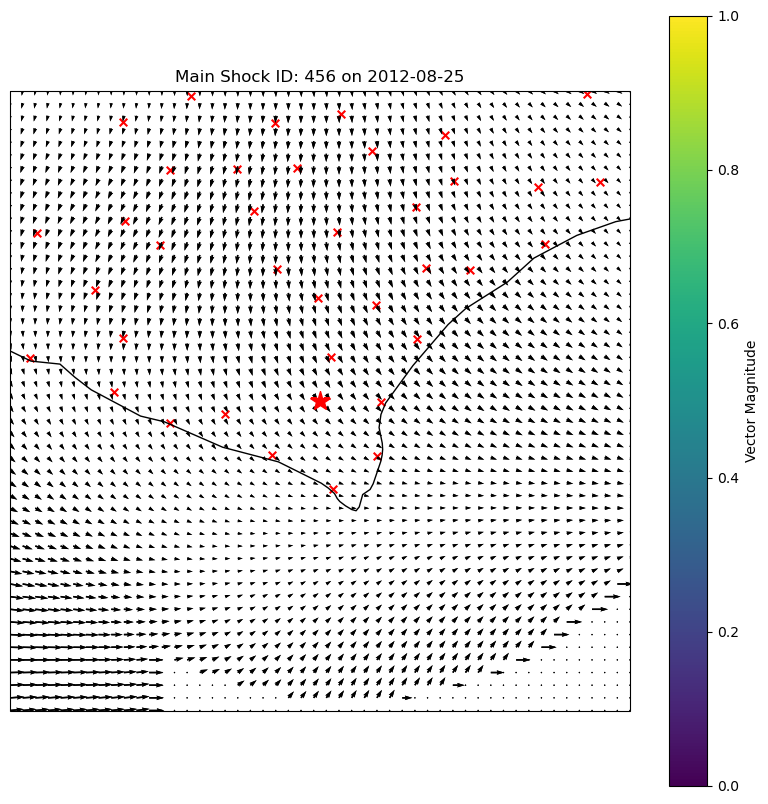

[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7, 6.0, 6.1, 6.8, 6.5, 7.2, 6.7, 6.6, 6.4, 6.2, 6.4, 6.3, 6.4, 7.8, 6.3, 7.3, 6.1, 6.2, 6.7, 6.4, 6.4, 6.3, 7.0, 6.0, 6.0, 6.1, 6.0, 6.9, 6.4, 6.5, 6.2, 6.2, 6.3, 6.6, 7.0, 6.1, 6.2, 7.0, 6.0, 6.0, 6.9, 6.6, 6.0, 6.0, 6.1, 6.0, 6.3, 6.1]
[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7, 6.0, 6.1, 6.8, 6.5, 7.2, 6.7, 6.6, 6.4, 6.2, 6.4, 6.3, 6.4, 7.8, 6.3, 7.3, 6.1, 6.2, 6.7, 6.4, 6.4, 6.3, 7.0, 6.0, 6.0, 6.1, 6.0, 6.9, 6.4, 6.5, 6.2, 6.2, 6.3, 6.6, 7.0, 6.1, 6.2, 7.0, 6.0, 6.0, 6.9, 6.6, 6.0, 6.0

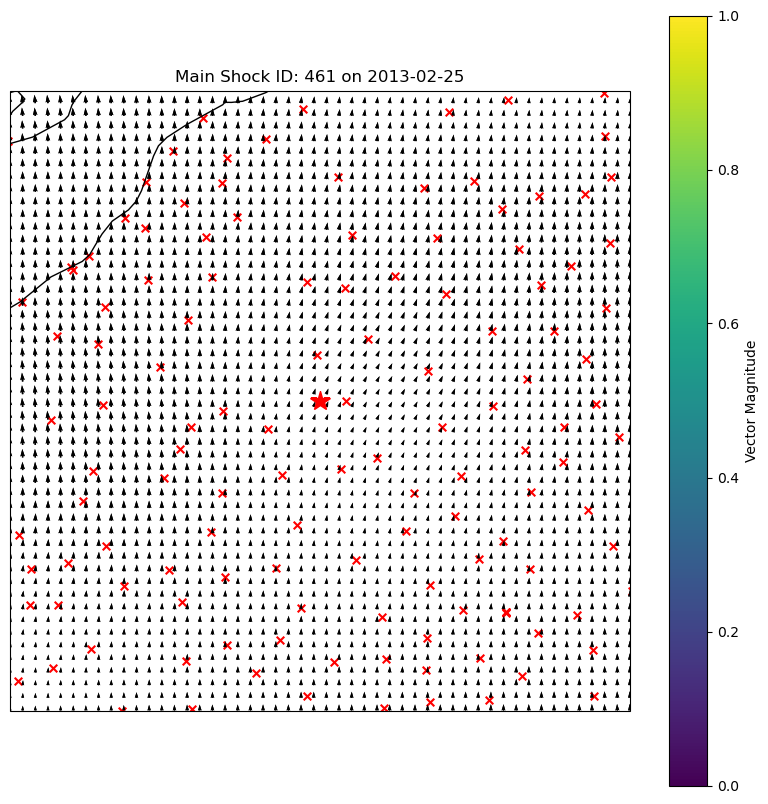

[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7, 6.0, 6.1, 6.8, 6.5, 7.2, 6.7, 6.6, 6.4, 6.2, 6.4, 6.3, 6.4, 7.8, 6.3, 7.3, 6.1, 6.2, 6.7, 6.4, 6.4, 6.3, 7.0, 6.0, 6.0, 6.1, 6.0, 6.9, 6.4, 6.5, 6.2, 6.2, 6.3, 6.6, 7.0, 6.1, 6.2, 7.0, 6.0, 6.0, 6.9, 6.6, 6.0, 6.0, 6.1, 6.0, 6.3, 6.1, 6.3, 7.3, 6.5, 6.3]
[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7, 6.0, 6.1, 6.8, 6.5, 7.2, 6.7, 6.6, 6.4, 6.2, 6.4, 6.3, 6.4, 7.8, 6.3, 7.3, 6.1, 6.2, 6.7, 6.4, 6.4, 6.3, 7.0, 6.0, 6.0, 6.1, 6.0, 6.9, 6.4, 6.5, 6.2, 6.2, 6.3, 6.6, 7.0, 6.1, 6.2, 7.0, 6.0, 6.0

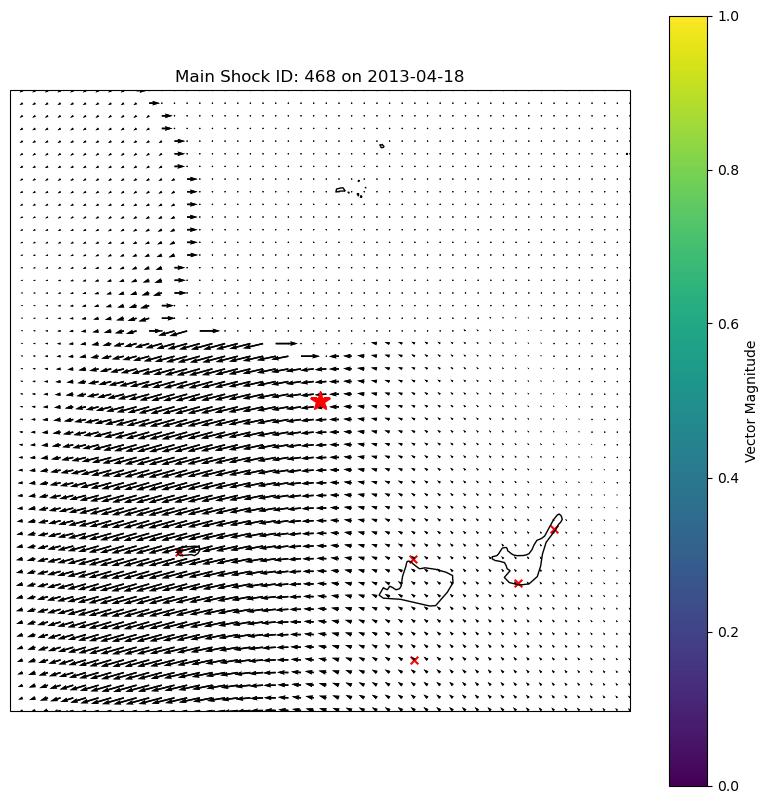

[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7, 6.0, 6.1, 6.8, 6.5, 7.2, 6.7, 6.6, 6.4, 6.2, 6.4, 6.3, 6.4, 7.8, 6.3, 7.3, 6.1, 6.2, 6.7, 6.4, 6.4, 6.3, 7.0, 6.0, 6.0, 6.1, 6.0, 6.9, 6.4, 6.5, 6.2, 6.2, 6.3, 6.6, 7.0, 6.1, 6.2, 7.0, 6.0, 6.0, 6.9, 6.6, 6.0, 6.0, 6.1, 6.0, 6.3, 6.1, 6.3, 7.3, 6.5, 6.3, 6.2, 6.2, 6.1]
[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7, 6.0, 6.1, 6.8, 6.5, 7.2, 6.7, 6.6, 6.4, 6.2, 6.4, 6.3, 6.4, 7.8, 6.3, 7.3, 6.1, 6.2, 6.7, 6.4, 6.4, 6.3, 7.0, 6.0, 6.0, 6.1, 6.0, 6.9, 6.4, 6.5, 6.2, 6.2, 6.3, 6.6, 7.0, 6.1, 6.2

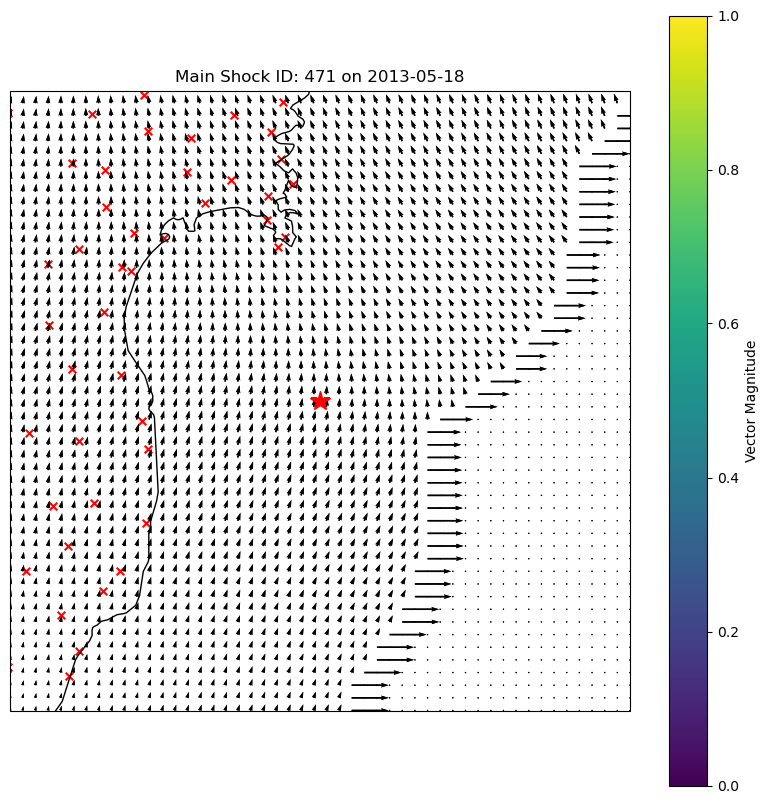

[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7, 6.0, 6.1, 6.8, 6.5, 7.2, 6.7, 6.6, 6.4, 6.2, 6.4, 6.3, 6.4, 7.8, 6.3, 7.3, 6.1, 6.2, 6.7, 6.4, 6.4, 6.3, 7.0, 6.0, 6.0, 6.1, 6.0, 6.9, 6.4, 6.5, 6.2, 6.2, 6.3, 6.6, 7.0, 6.1, 6.2, 7.0, 6.0, 6.0, 6.9, 6.6, 6.0, 6.0, 6.1, 6.0, 6.3, 6.1, 6.3, 7.3, 6.5, 6.3, 6.2, 6.2, 6.1, 6.0]
[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7, 6.0, 6.1, 6.8, 6.5, 7.2, 6.7, 6.6, 6.4, 6.2, 6.4, 6.3, 6.4, 7.8, 6.3, 7.3, 6.1, 6.2, 6.7, 6.4, 6.4, 6.3, 7.0, 6.0, 6.0, 6.1, 6.0, 6.9, 6.4, 6.5, 6.2, 6.2, 6.3, 6.6, 7.0, 6.1

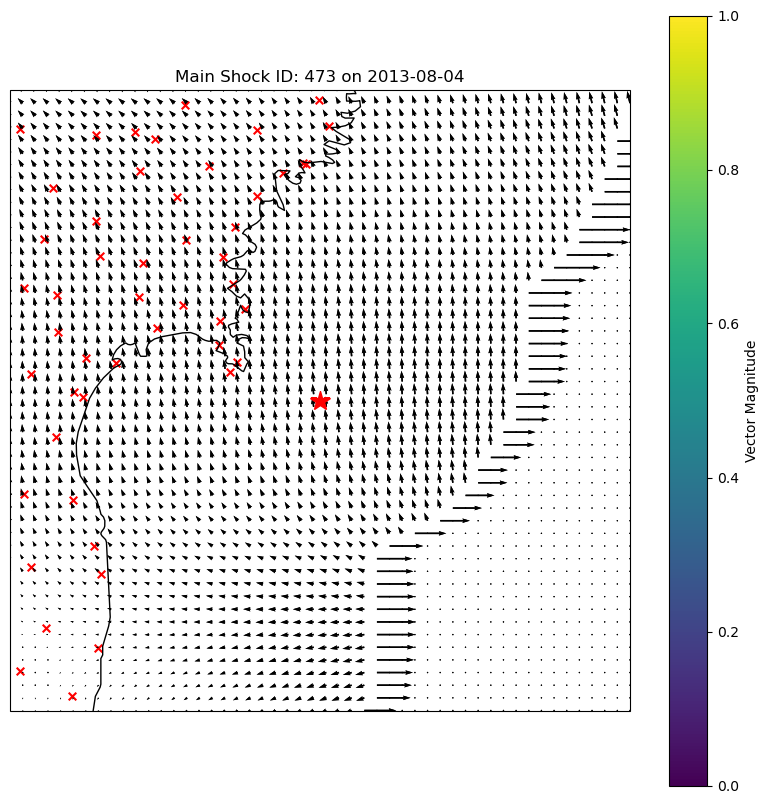

[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7, 6.0, 6.1, 6.8, 6.5, 7.2, 6.7, 6.6, 6.4, 6.2, 6.4, 6.3, 6.4, 7.8, 6.3, 7.3, 6.1, 6.2, 6.7, 6.4, 6.4, 6.3, 7.0, 6.0, 6.0, 6.1, 6.0, 6.9, 6.4, 6.5, 6.2, 6.2, 6.3, 6.6, 7.0, 6.1, 6.2, 7.0, 6.0, 6.0, 6.9, 6.6, 6.0, 6.0, 6.1, 6.0, 6.3, 6.1, 6.3, 7.3, 6.5, 6.3, 6.2, 6.2, 6.1, 6.0, 6.0]
[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7, 6.0, 6.1, 6.8, 6.5, 7.2, 6.7, 6.6, 6.4, 6.2, 6.4, 6.3, 6.4, 7.8, 6.3, 7.3, 6.1, 6.2, 6.7, 6.4, 6.4, 6.3, 7.0, 6.0, 6.0, 6.1, 6.0, 6.9, 6.4, 6.5, 6.2, 6.2, 6.3, 6.6, 7.0

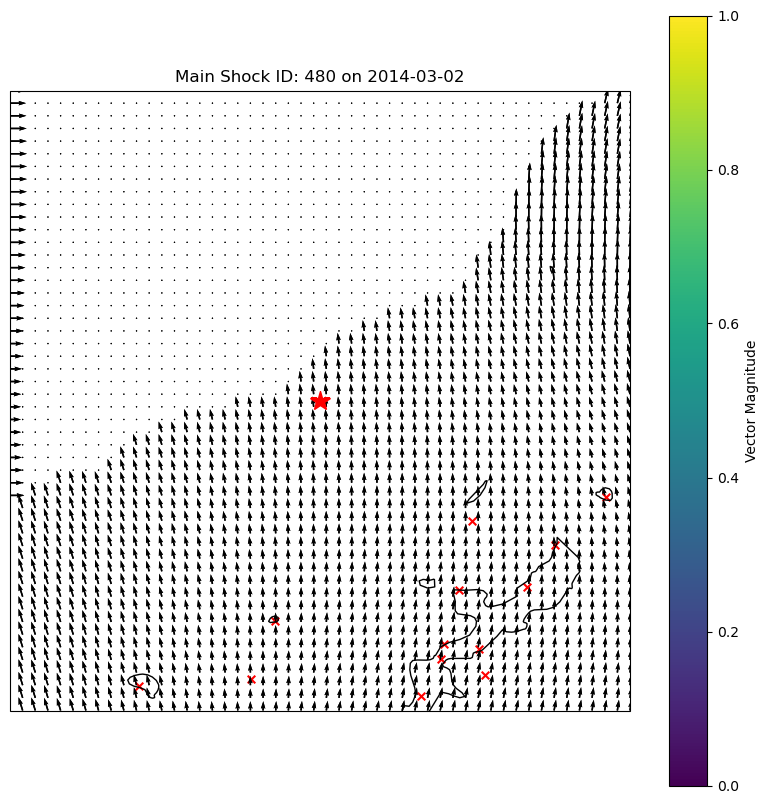

[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7, 6.0, 6.1, 6.8, 6.5, 7.2, 6.7, 6.6, 6.4, 6.2, 6.4, 6.3, 6.4, 7.8, 6.3, 7.3, 6.1, 6.2, 6.7, 6.4, 6.4, 6.3, 7.0, 6.0, 6.0, 6.1, 6.0, 6.9, 6.4, 6.5, 6.2, 6.2, 6.3, 6.6, 7.0, 6.1, 6.2, 7.0, 6.0, 6.0, 6.9, 6.6, 6.0, 6.0, 6.1, 6.0, 6.3, 6.1, 6.3, 7.3, 6.5, 6.3, 6.2, 6.2, 6.1, 6.0, 6.0, 6.4]
[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7, 6.0, 6.1, 6.8, 6.5, 7.2, 6.7, 6.6, 6.4, 6.2, 6.4, 6.3, 6.4, 7.8, 6.3, 7.3, 6.1, 6.2, 6.7, 6.4, 6.4, 6.3, 7.0, 6.0, 6.0, 6.1, 6.0, 6.9, 6.4, 6.5, 6.2, 6.2, 6.3, 6.6

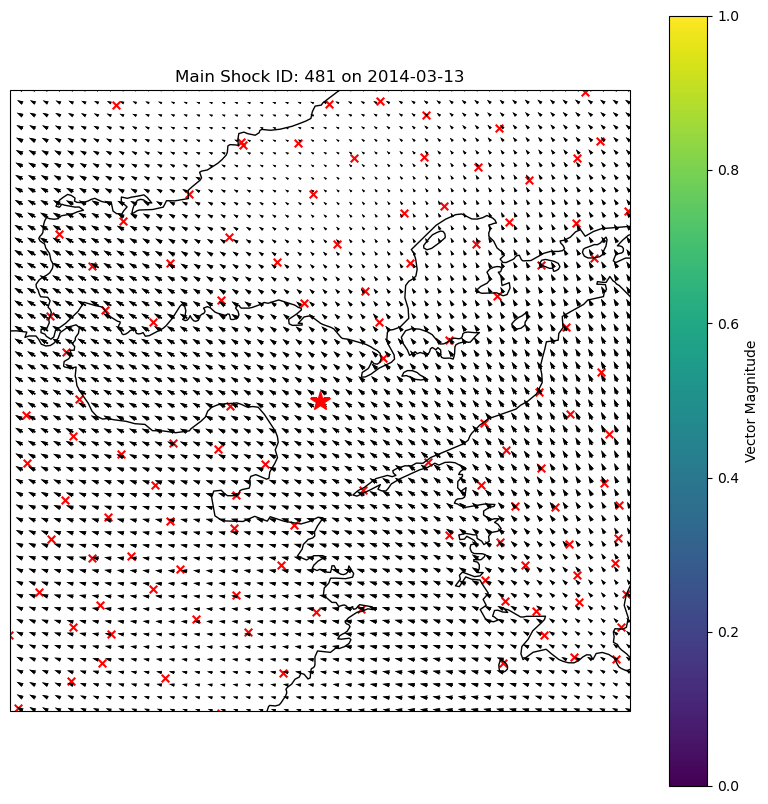

[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7, 6.0, 6.1, 6.8, 6.5, 7.2, 6.7, 6.6, 6.4, 6.2, 6.4, 6.3, 6.4, 7.8, 6.3, 7.3, 6.1, 6.2, 6.7, 6.4, 6.4, 6.3, 7.0, 6.0, 6.0, 6.1, 6.0, 6.9, 6.4, 6.5, 6.2, 6.2, 6.3, 6.6, 7.0, 6.1, 6.2, 7.0, 6.0, 6.0, 6.9, 6.6, 6.0, 6.0, 6.1, 6.0, 6.3, 6.1, 6.3, 7.3, 6.5, 6.3, 6.2, 6.2, 6.1, 6.0, 6.0, 6.4, 6.2]
[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7, 6.0, 6.1, 6.8, 6.5, 7.2, 6.7, 6.6, 6.4, 6.2, 6.4, 6.3, 6.4, 7.8, 6.3, 7.3, 6.1, 6.2, 6.7, 6.4, 6.4, 6.3, 7.0, 6.0, 6.0, 6.1, 6.0, 6.9, 6.4, 6.5, 6.2, 6.2, 6.3

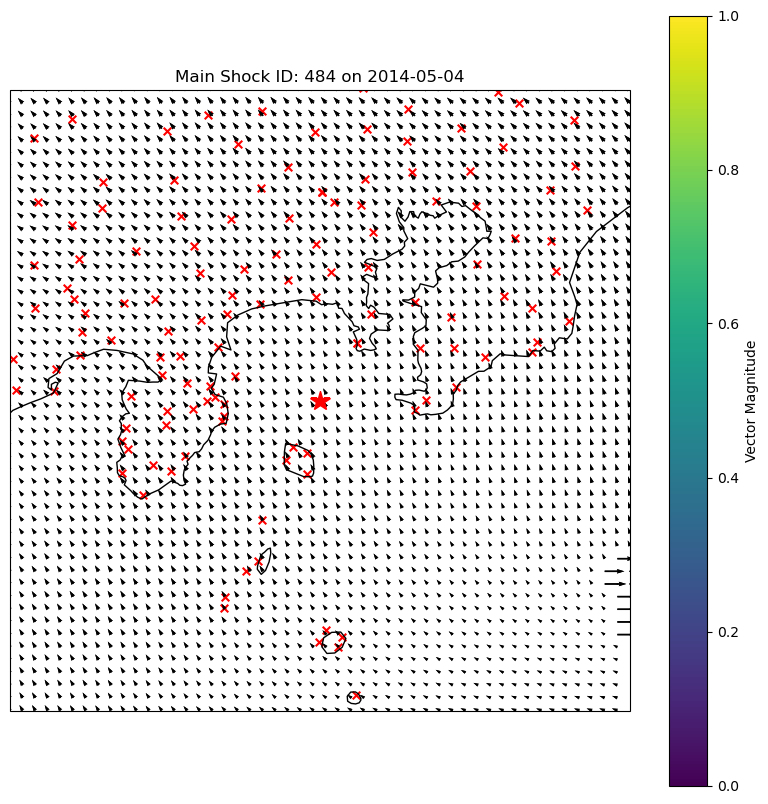

[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7, 6.0, 6.1, 6.8, 6.5, 7.2, 6.7, 6.6, 6.4, 6.2, 6.4, 6.3, 6.4, 7.8, 6.3, 7.3, 6.1, 6.2, 6.7, 6.4, 6.4, 6.3, 7.0, 6.0, 6.0, 6.1, 6.0, 6.9, 6.4, 6.5, 6.2, 6.2, 6.3, 6.6, 7.0, 6.1, 6.2, 7.0, 6.0, 6.0, 6.9, 6.6, 6.0, 6.0, 6.1, 6.0, 6.3, 6.1, 6.3, 7.3, 6.5, 6.3, 6.2, 6.2, 6.1, 6.0, 6.0, 6.4, 6.2, 6.0]
[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7, 6.0, 6.1, 6.8, 6.5, 7.2, 6.7, 6.6, 6.4, 6.2, 6.4, 6.3, 6.4, 7.8, 6.3, 7.3, 6.1, 6.2, 6.7, 6.4, 6.4, 6.3, 7.0, 6.0, 6.0, 6.1, 6.0, 6.9, 6.4, 6.5, 6.2, 6.2

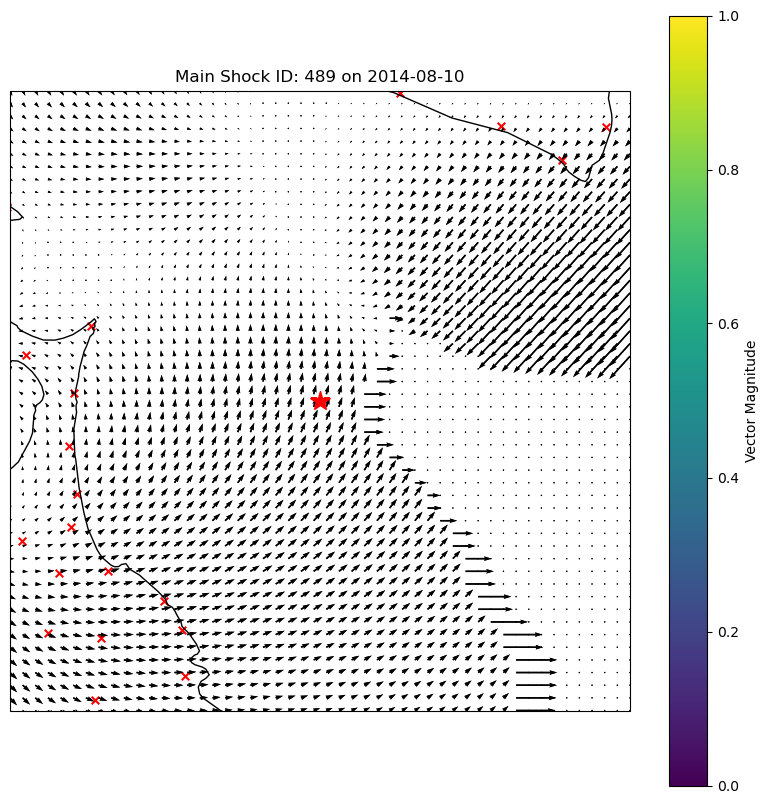

[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7, 6.0, 6.1, 6.8, 6.5, 7.2, 6.7, 6.6, 6.4, 6.2, 6.4, 6.3, 6.4, 7.8, 6.3, 7.3, 6.1, 6.2, 6.7, 6.4, 6.4, 6.3, 7.0, 6.0, 6.0, 6.1, 6.0, 6.9, 6.4, 6.5, 6.2, 6.2, 6.3, 6.6, 7.0, 6.1, 6.2, 7.0, 6.0, 6.0, 6.9, 6.6, 6.0, 6.0, 6.1, 6.0, 6.3, 6.1, 6.3, 7.3, 6.5, 6.3, 6.2, 6.2, 6.1, 6.0, 6.0, 6.4, 6.2, 6.0, 6.4, 7.0, 6.1]
[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7, 6.0, 6.1, 6.8, 6.5, 7.2, 6.7, 6.6, 6.4, 6.2, 6.4, 6.3, 6.4, 7.8, 6.3, 7.3, 6.1, 6.2, 6.7, 6.4, 6.4, 6.3, 7.0, 6.0, 6.0, 6.1, 6.0, 6.9, 6.4

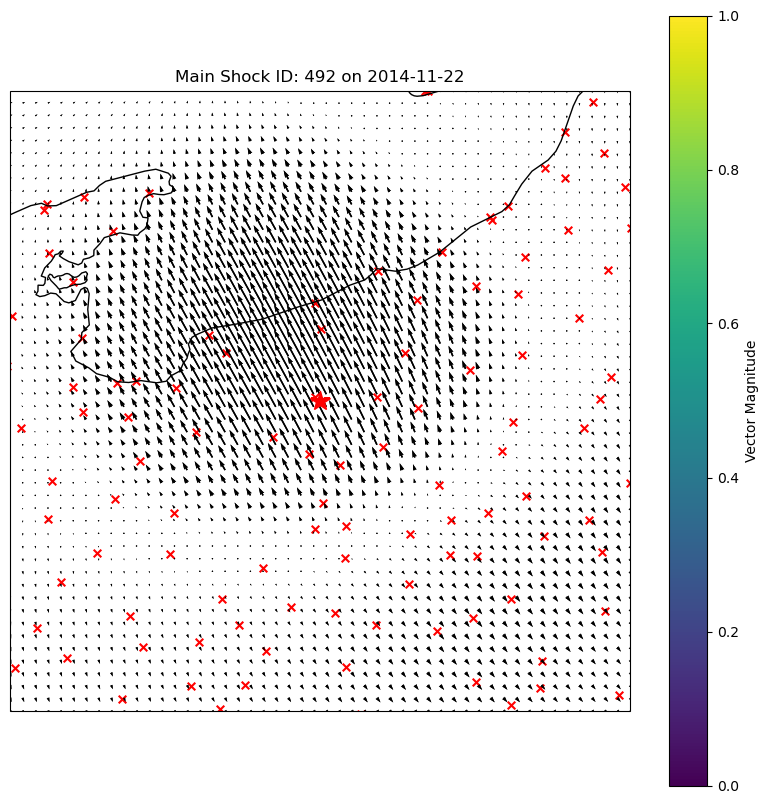

[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7, 6.0, 6.1, 6.8, 6.5, 7.2, 6.7, 6.6, 6.4, 6.2, 6.4, 6.3, 6.4, 7.8, 6.3, 7.3, 6.1, 6.2, 6.7, 6.4, 6.4, 6.3, 7.0, 6.0, 6.0, 6.1, 6.0, 6.9, 6.4, 6.5, 6.2, 6.2, 6.3, 6.6, 7.0, 6.1, 6.2, 7.0, 6.0, 6.0, 6.9, 6.6, 6.0, 6.0, 6.1, 6.0, 6.3, 6.1, 6.3, 7.3, 6.5, 6.3, 6.2, 6.2, 6.1, 6.0, 6.0, 6.4, 6.2, 6.0, 6.4, 7.0, 6.1, 6.1, 6.7]
[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7, 6.0, 6.1, 6.8, 6.5, 7.2, 6.7, 6.6, 6.4, 6.2, 6.4, 6.3, 6.4, 7.8, 6.3, 7.3, 6.1, 6.2, 6.7, 6.4, 6.4, 6.3, 7.0, 6.0, 6.0, 6.1, 6.0

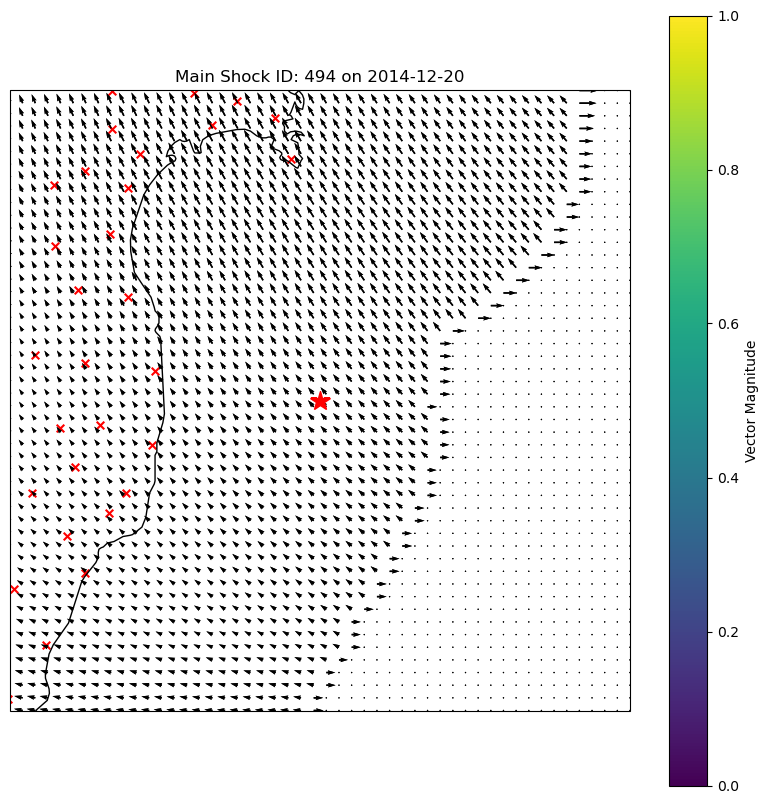

[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7, 6.0, 6.1, 6.8, 6.5, 7.2, 6.7, 6.6, 6.4, 6.2, 6.4, 6.3, 6.4, 7.8, 6.3, 7.3, 6.1, 6.2, 6.7, 6.4, 6.4, 6.3, 7.0, 6.0, 6.0, 6.1, 6.0, 6.9, 6.4, 6.5, 6.2, 6.2, 6.3, 6.6, 7.0, 6.1, 6.2, 7.0, 6.0, 6.0, 6.9, 6.6, 6.0, 6.0, 6.1, 6.0, 6.3, 6.1, 6.3, 7.3, 6.5, 6.3, 6.2, 6.2, 6.1, 6.0, 6.0, 6.4, 6.2, 6.0, 6.4, 7.0, 6.1, 6.1, 6.7, 6.0]
[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7, 6.0, 6.1, 6.8, 6.5, 7.2, 6.7, 6.6, 6.4, 6.2, 6.4, 6.3, 6.4, 7.8, 6.3, 7.3, 6.1, 6.2, 6.7, 6.4, 6.4, 6.3, 7.0, 6.0, 6.0, 6.1

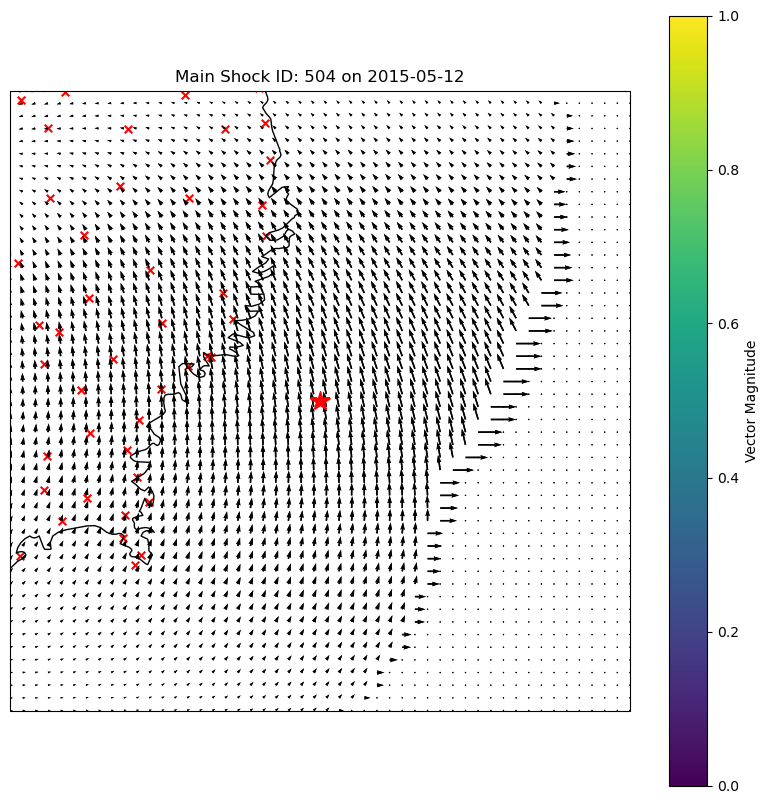

[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7, 6.0, 6.1, 6.8, 6.5, 7.2, 6.7, 6.6, 6.4, 6.2, 6.4, 6.3, 6.4, 7.8, 6.3, 7.3, 6.1, 6.2, 6.7, 6.4, 6.4, 6.3, 7.0, 6.0, 6.0, 6.1, 6.0, 6.9, 6.4, 6.5, 6.2, 6.2, 6.3, 6.6, 7.0, 6.1, 6.2, 7.0, 6.0, 6.0, 6.9, 6.6, 6.0, 6.0, 6.1, 6.0, 6.3, 6.1, 6.3, 7.3, 6.5, 6.3, 6.2, 6.2, 6.1, 6.0, 6.0, 6.4, 6.2, 6.0, 6.4, 7.0, 6.1, 6.1, 6.7, 6.0, 6.9, 6.8]
[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7, 6.0, 6.1, 6.8, 6.5, 7.2, 6.7, 6.6, 6.4, 6.2, 6.4, 6.3, 6.4, 7.8, 6.3, 7.3, 6.1, 6.2, 6.7, 6.4, 6.4, 6.3, 7.0, 6.0

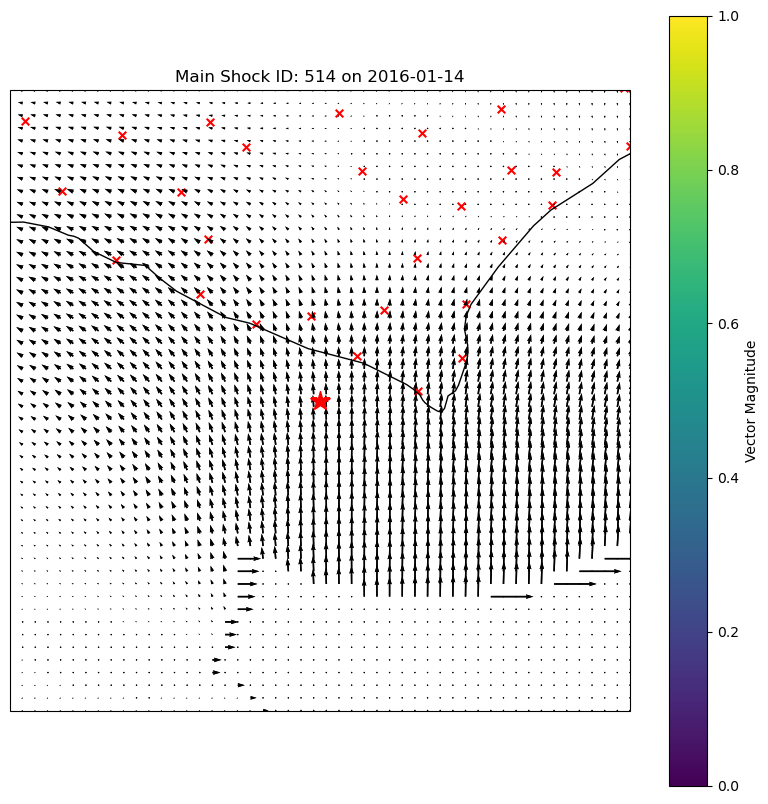

[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7, 6.0, 6.1, 6.8, 6.5, 7.2, 6.7, 6.6, 6.4, 6.2, 6.4, 6.3, 6.4, 7.8, 6.3, 7.3, 6.1, 6.2, 6.7, 6.4, 6.4, 6.3, 7.0, 6.0, 6.0, 6.1, 6.0, 6.9, 6.4, 6.5, 6.2, 6.2, 6.3, 6.6, 7.0, 6.1, 6.2, 7.0, 6.0, 6.0, 6.9, 6.6, 6.0, 6.0, 6.1, 6.0, 6.3, 6.1, 6.3, 7.3, 6.5, 6.3, 6.2, 6.2, 6.1, 6.0, 6.0, 6.4, 6.2, 6.0, 6.4, 7.0, 6.1, 6.1, 6.7, 6.0, 6.9, 6.8, 8.1, 6.3, 7.1, 6.3, 6.7]
[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7, 6.0, 6.1, 6.8, 6.5, 7.2, 6.7, 6.6, 6.4, 6.2, 6.4, 6.3, 6.4, 7.8, 6.3, 7.3, 6.1, 6.2, 6.7

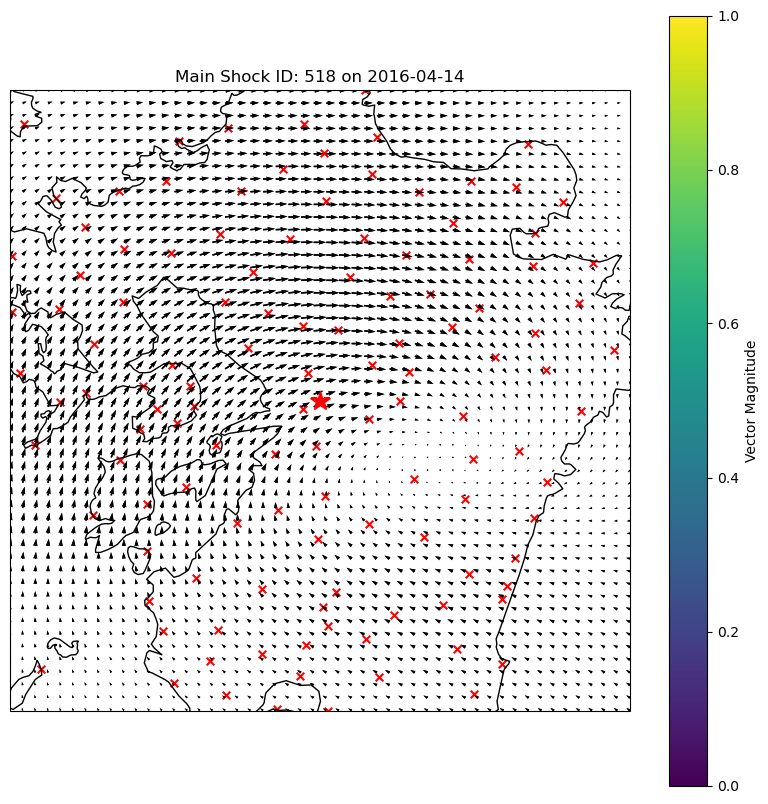

[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7, 6.0, 6.1, 6.8, 6.5, 7.2, 6.7, 6.6, 6.4, 6.2, 6.4, 6.3, 6.4, 7.8, 6.3, 7.3, 6.1, 6.2, 6.7, 6.4, 6.4, 6.3, 7.0, 6.0, 6.0, 6.1, 6.0, 6.9, 6.4, 6.5, 6.2, 6.2, 6.3, 6.6, 7.0, 6.1, 6.2, 7.0, 6.0, 6.0, 6.9, 6.6, 6.0, 6.0, 6.1, 6.0, 6.3, 6.1, 6.3, 7.3, 6.5, 6.3, 6.2, 6.2, 6.1, 6.0, 6.0, 6.4, 6.2, 6.0, 6.4, 7.0, 6.1, 6.1, 6.7, 6.0, 6.9, 6.8, 8.1, 6.3, 7.1, 6.3, 6.7, 6.5, 6.5]
[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7, 6.0, 6.1, 6.8, 6.5, 7.2, 6.7, 6.6, 6.4, 6.2, 6.4, 6.3, 6.4, 7.8, 6.3, 7.3, 6.1

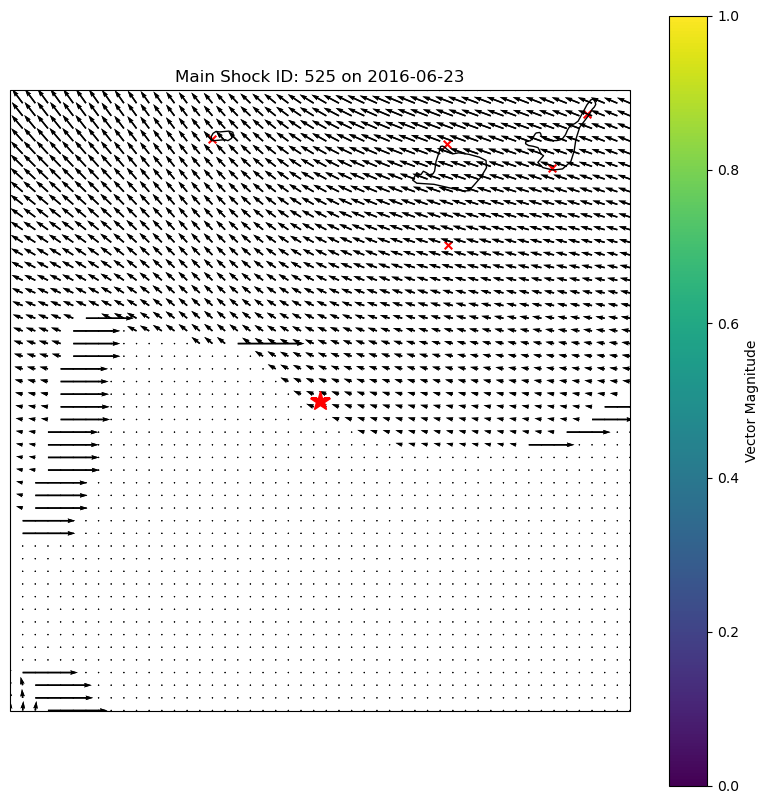

[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7, 6.0, 6.1, 6.8, 6.5, 7.2, 6.7, 6.6, 6.4, 6.2, 6.4, 6.3, 6.4, 7.8, 6.3, 7.3, 6.1, 6.2, 6.7, 6.4, 6.4, 6.3, 7.0, 6.0, 6.0, 6.1, 6.0, 6.9, 6.4, 6.5, 6.2, 6.2, 6.3, 6.6, 7.0, 6.1, 6.2, 7.0, 6.0, 6.0, 6.9, 6.6, 6.0, 6.0, 6.1, 6.0, 6.3, 6.1, 6.3, 7.3, 6.5, 6.3, 6.2, 6.2, 6.1, 6.0, 6.0, 6.4, 6.2, 6.0, 6.4, 7.0, 6.1, 6.1, 6.7, 6.0, 6.9, 6.8, 8.1, 6.3, 7.1, 6.3, 6.7, 6.5, 6.5, 6.2]
[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7, 6.0, 6.1, 6.8, 6.5, 7.2, 6.7, 6.6, 6.4, 6.2, 6.4, 6.3, 6.4, 7.8, 6.3, 7.3

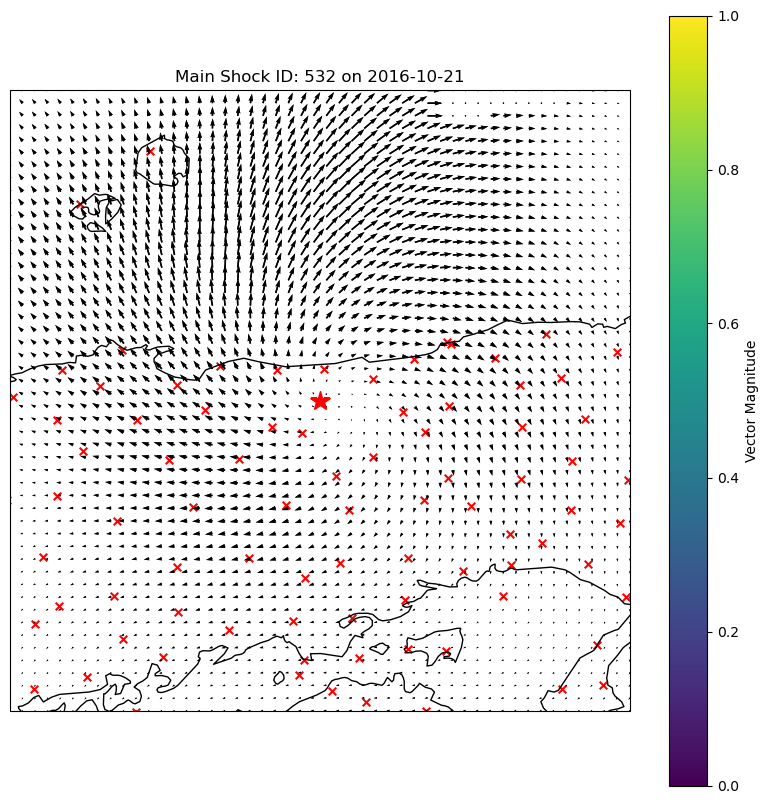

[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7, 6.0, 6.1, 6.8, 6.5, 7.2, 6.7, 6.6, 6.4, 6.2, 6.4, 6.3, 6.4, 7.8, 6.3, 7.3, 6.1, 6.2, 6.7, 6.4, 6.4, 6.3, 7.0, 6.0, 6.0, 6.1, 6.0, 6.9, 6.4, 6.5, 6.2, 6.2, 6.3, 6.6, 7.0, 6.1, 6.2, 7.0, 6.0, 6.0, 6.9, 6.6, 6.0, 6.0, 6.1, 6.0, 6.3, 6.1, 6.3, 7.3, 6.5, 6.3, 6.2, 6.2, 6.1, 6.0, 6.0, 6.4, 6.2, 6.0, 6.4, 7.0, 6.1, 6.1, 6.7, 6.0, 6.9, 6.8, 8.1, 6.3, 7.1, 6.3, 6.7, 6.5, 6.5, 6.2, 6.4, 6.4, 6.7, 6.6]
[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7, 6.0, 6.1, 6.8, 6.5, 7.2, 6.7, 6.6, 6.4, 6.2, 6.4, 6.3

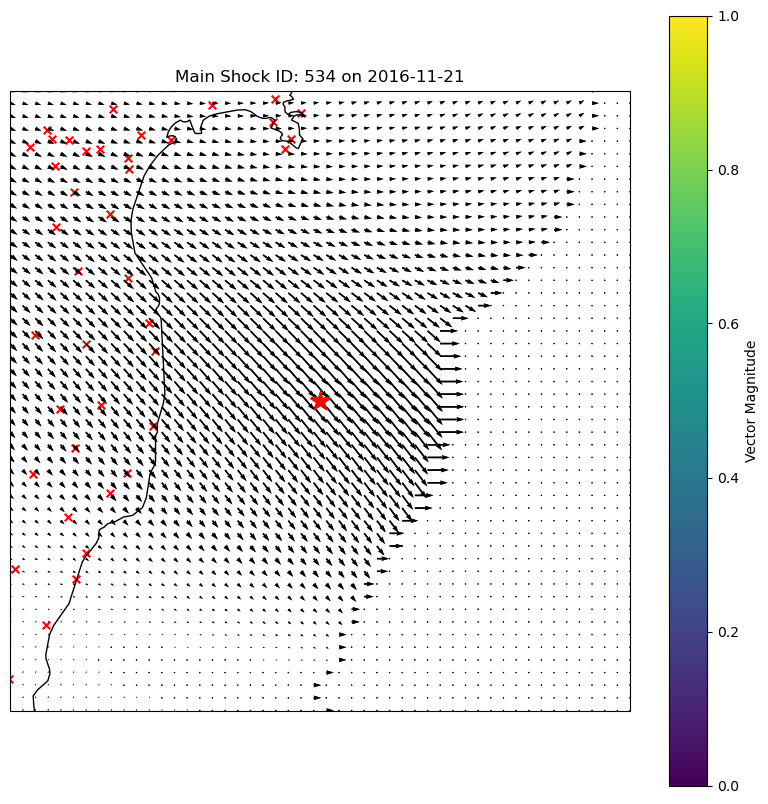

[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7, 6.0, 6.1, 6.8, 6.5, 7.2, 6.7, 6.6, 6.4, 6.2, 6.4, 6.3, 6.4, 7.8, 6.3, 7.3, 6.1, 6.2, 6.7, 6.4, 6.4, 6.3, 7.0, 6.0, 6.0, 6.1, 6.0, 6.9, 6.4, 6.5, 6.2, 6.2, 6.3, 6.6, 7.0, 6.1, 6.2, 7.0, 6.0, 6.0, 6.9, 6.6, 6.0, 6.0, 6.1, 6.0, 6.3, 6.1, 6.3, 7.3, 6.5, 6.3, 6.2, 6.2, 6.1, 6.0, 6.0, 6.4, 6.2, 6.0, 6.4, 7.0, 6.1, 6.1, 6.7, 6.0, 6.9, 6.8, 8.1, 6.3, 7.1, 6.3, 6.7, 6.5, 6.5, 6.2, 6.4, 6.4, 6.7, 6.6, 6.0, 7.4]
[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7, 6.0, 6.1, 6.8, 6.5, 7.2, 6.7, 6.6, 6.4, 6.2

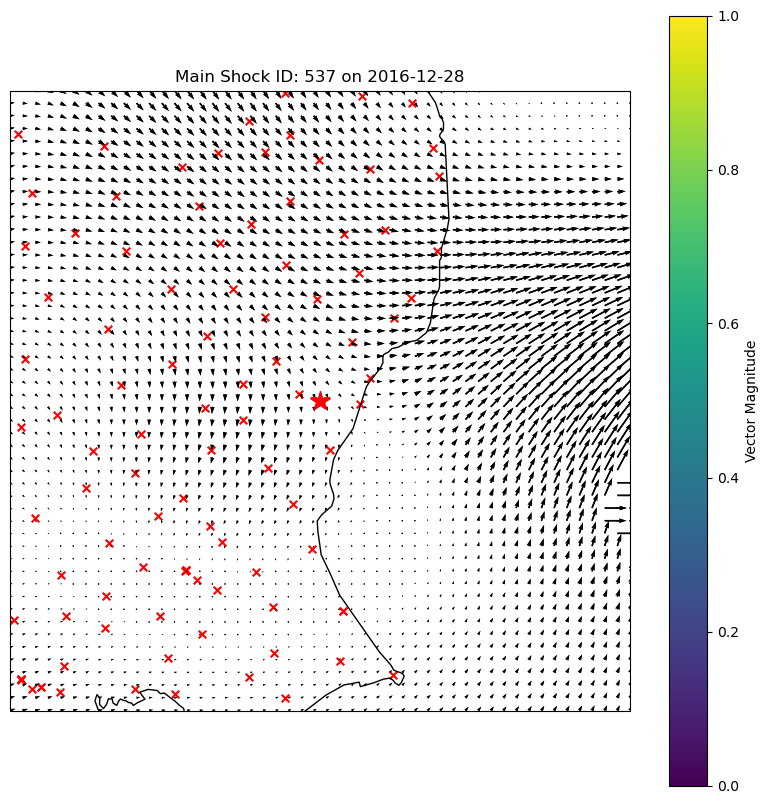

[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7, 6.0, 6.1, 6.8, 6.5, 7.2, 6.7, 6.6, 6.4, 6.2, 6.4, 6.3, 6.4, 7.8, 6.3, 7.3, 6.1, 6.2, 6.7, 6.4, 6.4, 6.3, 7.0, 6.0, 6.0, 6.1, 6.0, 6.9, 6.4, 6.5, 6.2, 6.2, 6.3, 6.6, 7.0, 6.1, 6.2, 7.0, 6.0, 6.0, 6.9, 6.6, 6.0, 6.0, 6.1, 6.0, 6.3, 6.1, 6.3, 7.3, 6.5, 6.3, 6.2, 6.2, 6.1, 6.0, 6.0, 6.4, 6.2, 6.0, 6.4, 7.0, 6.1, 6.1, 6.7, 6.0, 6.9, 6.8, 8.1, 6.3, 7.1, 6.3, 6.7, 6.5, 6.5, 6.2, 6.4, 6.4, 6.7, 6.6, 6.0, 7.4, 6.3]
[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7, 6.0, 6.1, 6.8, 6.5, 7.2, 6.7, 6.6, 6.4

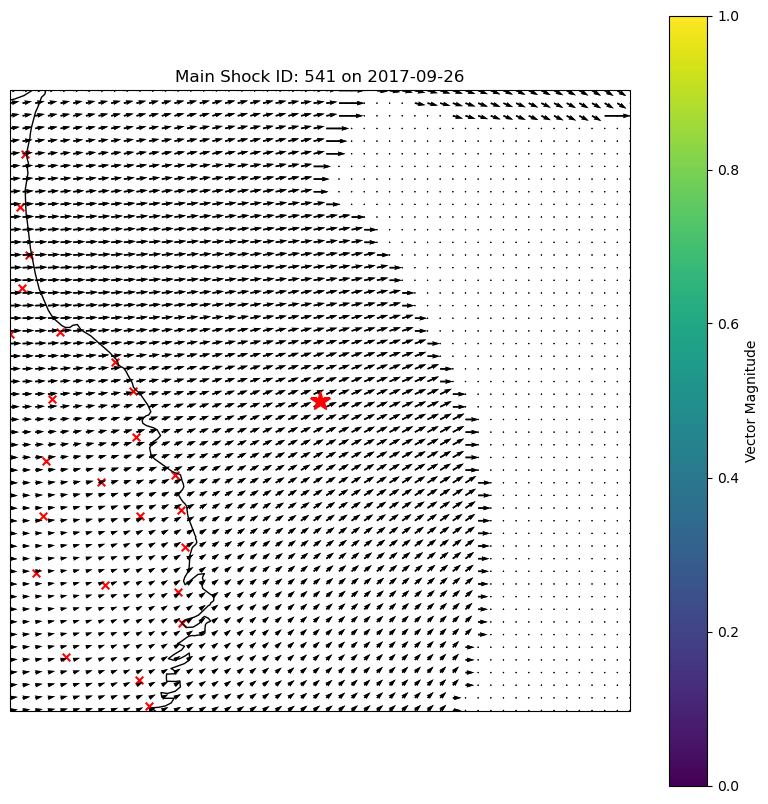

[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7, 6.0, 6.1, 6.8, 6.5, 7.2, 6.7, 6.6, 6.4, 6.2, 6.4, 6.3, 6.4, 7.8, 6.3, 7.3, 6.1, 6.2, 6.7, 6.4, 6.4, 6.3, 7.0, 6.0, 6.0, 6.1, 6.0, 6.9, 6.4, 6.5, 6.2, 6.2, 6.3, 6.6, 7.0, 6.1, 6.2, 7.0, 6.0, 6.0, 6.9, 6.6, 6.0, 6.0, 6.1, 6.0, 6.3, 6.1, 6.3, 7.3, 6.5, 6.3, 6.2, 6.2, 6.1, 6.0, 6.0, 6.4, 6.2, 6.0, 6.4, 7.0, 6.1, 6.1, 6.7, 6.0, 6.9, 6.8, 8.1, 6.3, 7.1, 6.3, 6.7, 6.5, 6.5, 6.2, 6.4, 6.4, 6.7, 6.6, 6.0, 7.4, 6.3, 6.4, 6.1, 6.3, 6.1]
[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7, 6.0, 6.1, 6.8, 6.5

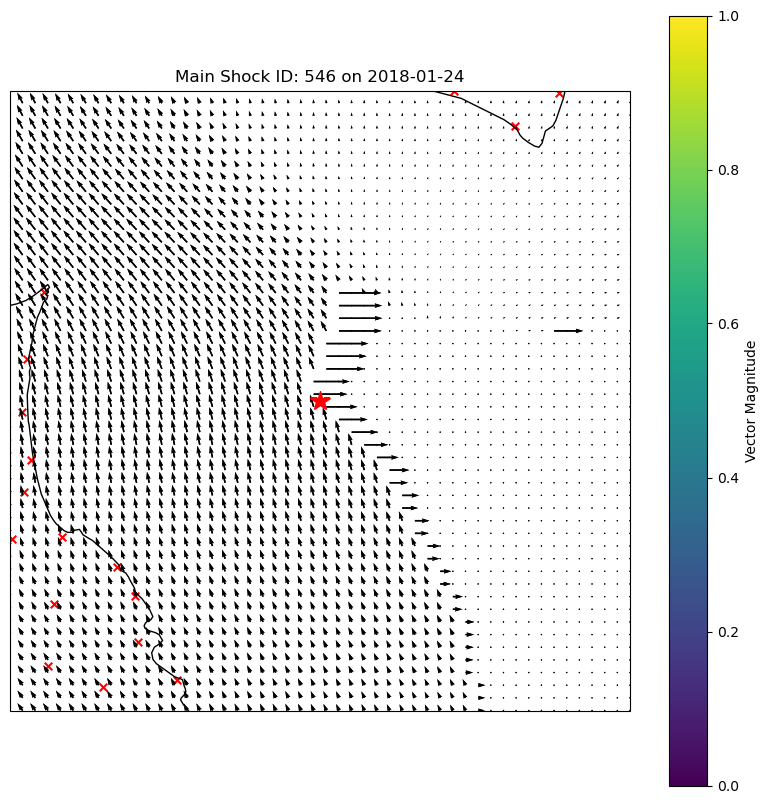

[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7, 6.0, 6.1, 6.8, 6.5, 7.2, 6.7, 6.6, 6.4, 6.2, 6.4, 6.3, 6.4, 7.8, 6.3, 7.3, 6.1, 6.2, 6.7, 6.4, 6.4, 6.3, 7.0, 6.0, 6.0, 6.1, 6.0, 6.9, 6.4, 6.5, 6.2, 6.2, 6.3, 6.6, 7.0, 6.1, 6.2, 7.0, 6.0, 6.0, 6.9, 6.6, 6.0, 6.0, 6.1, 6.0, 6.3, 6.1, 6.3, 7.3, 6.5, 6.3, 6.2, 6.2, 6.1, 6.0, 6.0, 6.4, 6.2, 6.0, 6.4, 7.0, 6.1, 6.1, 6.7, 6.0, 6.9, 6.8, 8.1, 6.3, 7.1, 6.3, 6.7, 6.5, 6.5, 6.2, 6.4, 6.4, 6.7, 6.6, 6.0, 7.4, 6.3, 6.4, 6.1, 6.3, 6.1, 6.0, 6.0, 6.3]
[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7, 6.0

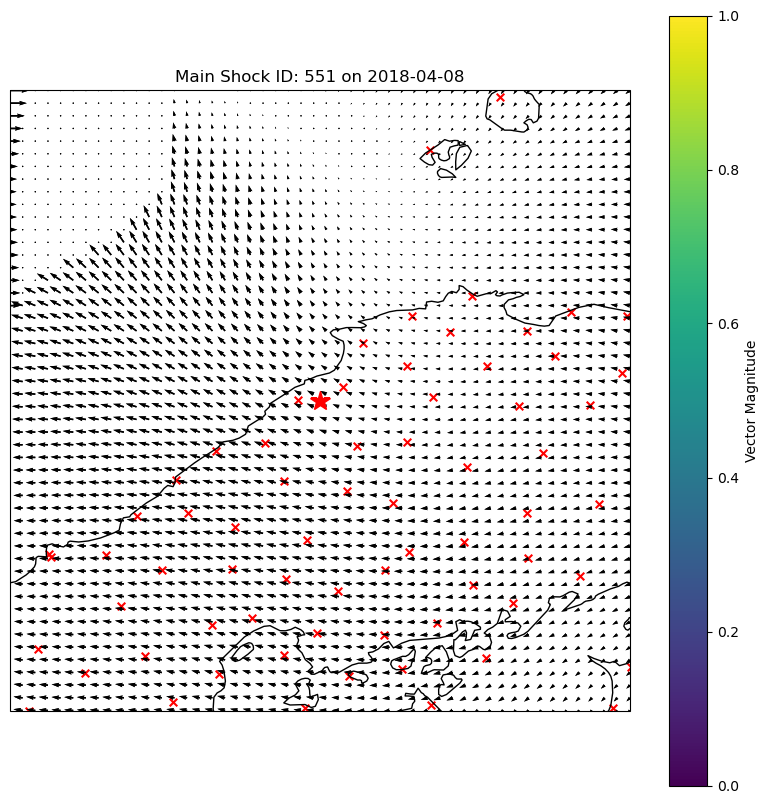

[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7, 6.0, 6.1, 6.8, 6.5, 7.2, 6.7, 6.6, 6.4, 6.2, 6.4, 6.3, 6.4, 7.8, 6.3, 7.3, 6.1, 6.2, 6.7, 6.4, 6.4, 6.3, 7.0, 6.0, 6.0, 6.1, 6.0, 6.9, 6.4, 6.5, 6.2, 6.2, 6.3, 6.6, 7.0, 6.1, 6.2, 7.0, 6.0, 6.0, 6.9, 6.6, 6.0, 6.0, 6.1, 6.0, 6.3, 6.1, 6.3, 7.3, 6.5, 6.3, 6.2, 6.2, 6.1, 6.0, 6.0, 6.4, 6.2, 6.0, 6.4, 7.0, 6.1, 6.1, 6.7, 6.0, 6.9, 6.8, 8.1, 6.3, 7.1, 6.3, 6.7, 6.5, 6.5, 6.2, 6.4, 6.4, 6.7, 6.6, 6.0, 7.4, 6.3, 6.4, 6.1, 6.3, 6.1, 6.0, 6.0, 6.3, 6.1]
[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7

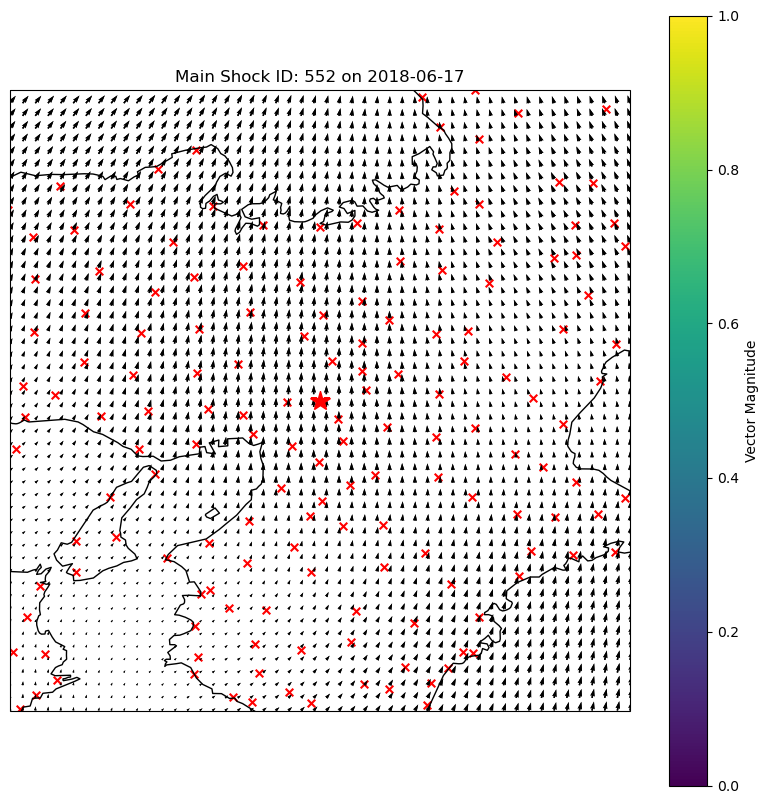

[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7, 6.0, 6.1, 6.8, 6.5, 7.2, 6.7, 6.6, 6.4, 6.2, 6.4, 6.3, 6.4, 7.8, 6.3, 7.3, 6.1, 6.2, 6.7, 6.4, 6.4, 6.3, 7.0, 6.0, 6.0, 6.1, 6.0, 6.9, 6.4, 6.5, 6.2, 6.2, 6.3, 6.6, 7.0, 6.1, 6.2, 7.0, 6.0, 6.0, 6.9, 6.6, 6.0, 6.0, 6.1, 6.0, 6.3, 6.1, 6.3, 7.3, 6.5, 6.3, 6.2, 6.2, 6.1, 6.0, 6.0, 6.4, 6.2, 6.0, 6.4, 7.0, 6.1, 6.1, 6.7, 6.0, 6.9, 6.8, 8.1, 6.3, 7.1, 6.3, 6.7, 6.5, 6.5, 6.2, 6.4, 6.4, 6.7, 6.6, 6.0, 7.4, 6.3, 6.4, 6.1, 6.3, 6.1, 6.0, 6.0, 6.3, 6.1, 6.1]
[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6

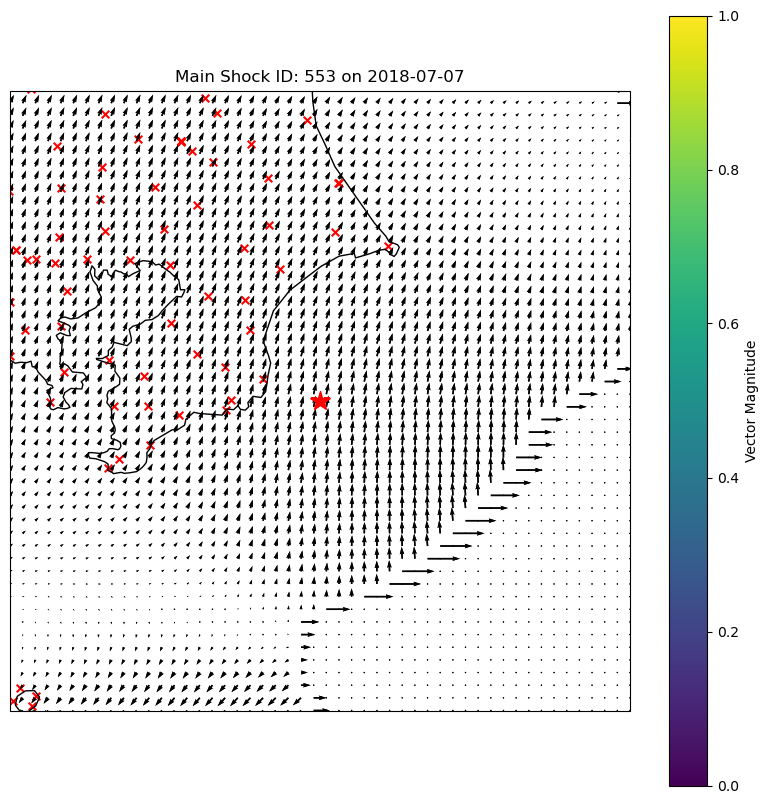

[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7, 6.0, 6.1, 6.8, 6.5, 7.2, 6.7, 6.6, 6.4, 6.2, 6.4, 6.3, 6.4, 7.8, 6.3, 7.3, 6.1, 6.2, 6.7, 6.4, 6.4, 6.3, 7.0, 6.0, 6.0, 6.1, 6.0, 6.9, 6.4, 6.5, 6.2, 6.2, 6.3, 6.6, 7.0, 6.1, 6.2, 7.0, 6.0, 6.0, 6.9, 6.6, 6.0, 6.0, 6.1, 6.0, 6.3, 6.1, 6.3, 7.3, 6.5, 6.3, 6.2, 6.2, 6.1, 6.0, 6.0, 6.4, 6.2, 6.0, 6.4, 7.0, 6.1, 6.1, 6.7, 6.0, 6.9, 6.8, 8.1, 6.3, 7.1, 6.3, 6.7, 6.5, 6.5, 6.2, 6.4, 6.4, 6.7, 6.6, 6.0, 7.4, 6.3, 6.4, 6.1, 6.3, 6.1, 6.0, 6.0, 6.3, 6.1, 6.1, 6.0]
[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5

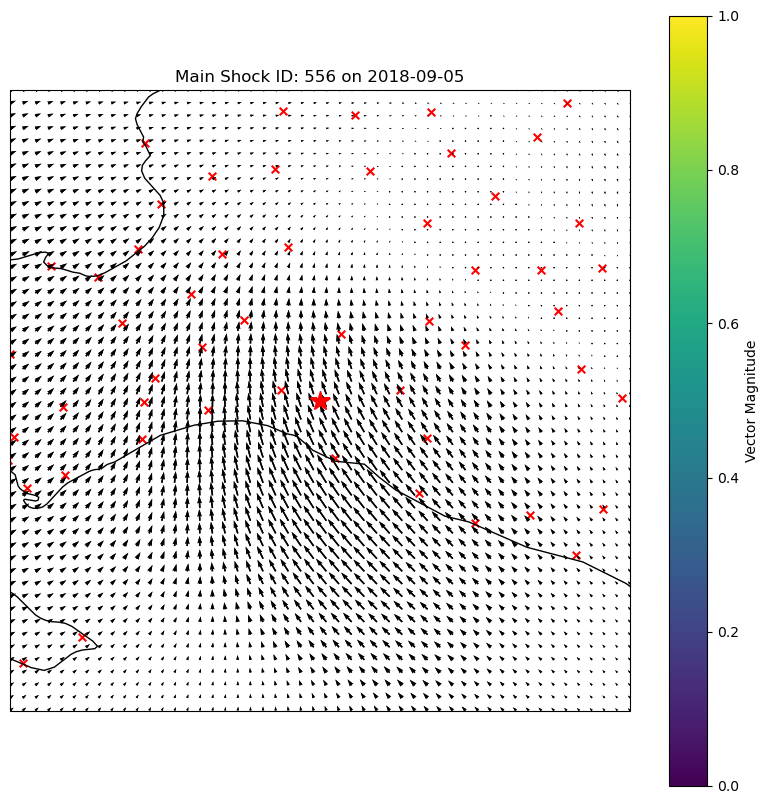

[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7, 6.0, 6.1, 6.8, 6.5, 7.2, 6.7, 6.6, 6.4, 6.2, 6.4, 6.3, 6.4, 7.8, 6.3, 7.3, 6.1, 6.2, 6.7, 6.4, 6.4, 6.3, 7.0, 6.0, 6.0, 6.1, 6.0, 6.9, 6.4, 6.5, 6.2, 6.2, 6.3, 6.6, 7.0, 6.1, 6.2, 7.0, 6.0, 6.0, 6.9, 6.6, 6.0, 6.0, 6.1, 6.0, 6.3, 6.1, 6.3, 7.3, 6.5, 6.3, 6.2, 6.2, 6.1, 6.0, 6.0, 6.4, 6.2, 6.0, 6.4, 7.0, 6.1, 6.1, 6.7, 6.0, 6.9, 6.8, 8.1, 6.3, 7.1, 6.3, 6.7, 6.5, 6.5, 6.2, 6.4, 6.4, 6.7, 6.6, 6.0, 7.4, 6.3, 6.4, 6.1, 6.3, 6.1, 6.0, 6.0, 6.3, 6.1, 6.1, 6.0, 6.3, 6.7]
[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5

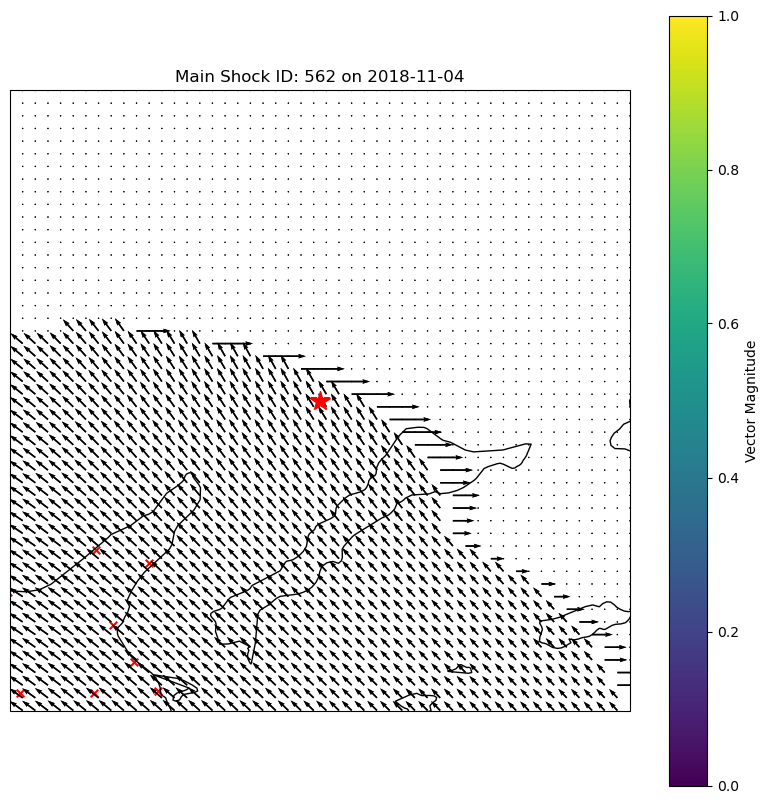

[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7, 6.0, 6.1, 6.8, 6.5, 7.2, 6.7, 6.6, 6.4, 6.2, 6.4, 6.3, 6.4, 7.8, 6.3, 7.3, 6.1, 6.2, 6.7, 6.4, 6.4, 6.3, 7.0, 6.0, 6.0, 6.1, 6.0, 6.9, 6.4, 6.5, 6.2, 6.2, 6.3, 6.6, 7.0, 6.1, 6.2, 7.0, 6.0, 6.0, 6.9, 6.6, 6.0, 6.0, 6.1, 6.0, 6.3, 6.1, 6.3, 7.3, 6.5, 6.3, 6.2, 6.2, 6.1, 6.0, 6.0, 6.4, 6.2, 6.0, 6.4, 7.0, 6.1, 6.1, 6.7, 6.0, 6.9, 6.8, 8.1, 6.3, 7.1, 6.3, 6.7, 6.5, 6.5, 6.2, 6.4, 6.4, 6.7, 6.6, 6.0, 7.4, 6.3, 6.4, 6.1, 6.3, 6.1, 6.0, 6.0, 6.3, 6.1, 6.1, 6.0, 6.3, 6.7, 6.2, 6.3]
[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6

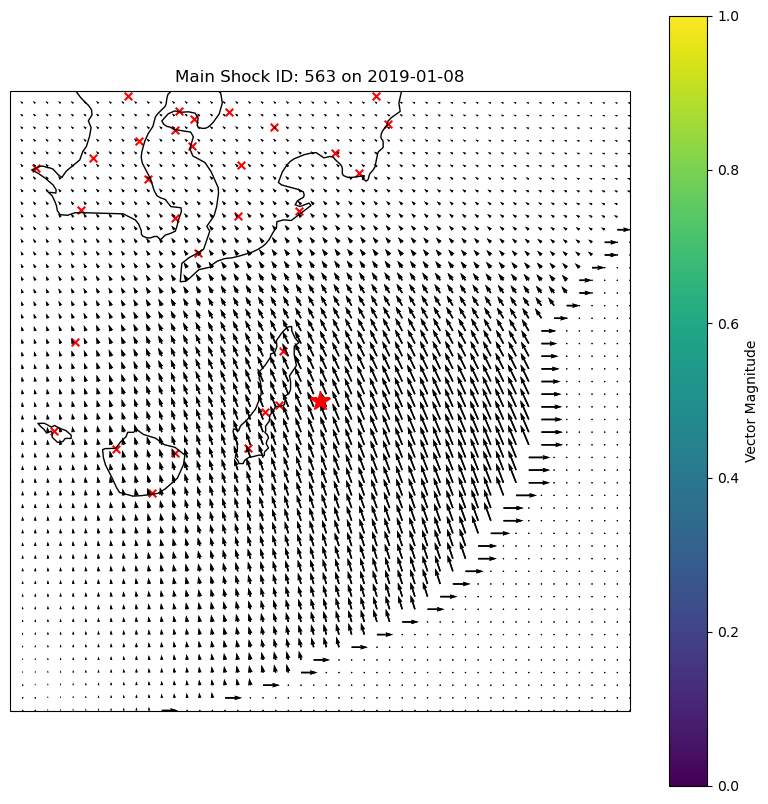

[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7, 6.0, 6.1, 6.8, 6.5, 7.2, 6.7, 6.6, 6.4, 6.2, 6.4, 6.3, 6.4, 7.8, 6.3, 7.3, 6.1, 6.2, 6.7, 6.4, 6.4, 6.3, 7.0, 6.0, 6.0, 6.1, 6.0, 6.9, 6.4, 6.5, 6.2, 6.2, 6.3, 6.6, 7.0, 6.1, 6.2, 7.0, 6.0, 6.0, 6.9, 6.6, 6.0, 6.0, 6.1, 6.0, 6.3, 6.1, 6.3, 7.3, 6.5, 6.3, 6.2, 6.2, 6.1, 6.0, 6.0, 6.4, 6.2, 6.0, 6.4, 7.0, 6.1, 6.1, 6.7, 6.0, 6.9, 6.8, 8.1, 6.3, 7.1, 6.3, 6.7, 6.5, 6.5, 6.2, 6.4, 6.4, 6.7, 6.6, 6.0, 7.4, 6.3, 6.4, 6.1, 6.3, 6.1, 6.0, 6.0, 6.3, 6.1, 6.1, 6.0, 6.3, 6.7, 6.2, 6.3, 6.0]
[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1

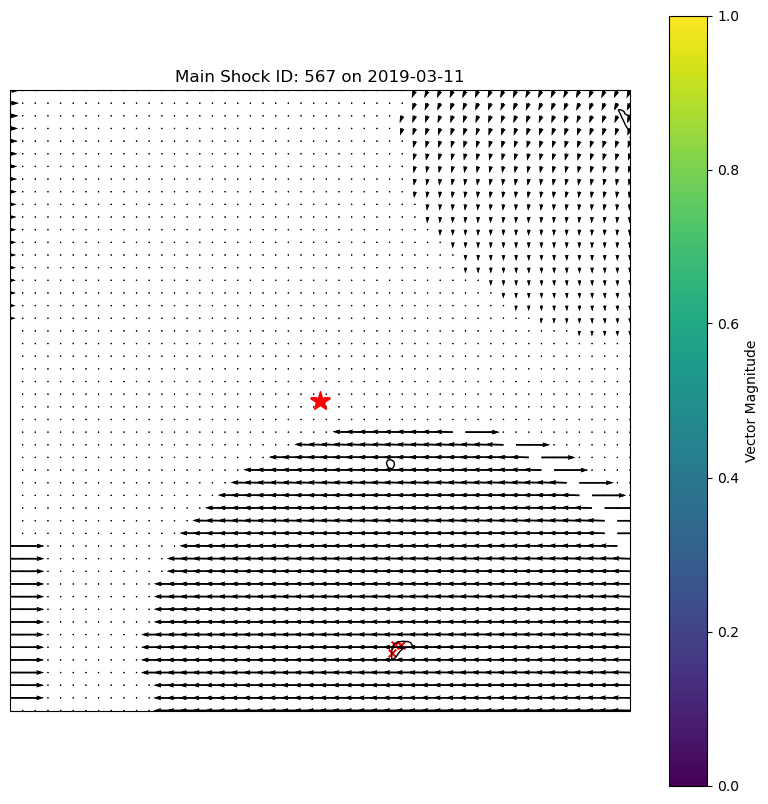

[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7, 6.0, 6.1, 6.8, 6.5, 7.2, 6.7, 6.6, 6.4, 6.2, 6.4, 6.3, 6.4, 7.8, 6.3, 7.3, 6.1, 6.2, 6.7, 6.4, 6.4, 6.3, 7.0, 6.0, 6.0, 6.1, 6.0, 6.9, 6.4, 6.5, 6.2, 6.2, 6.3, 6.6, 7.0, 6.1, 6.2, 7.0, 6.0, 6.0, 6.9, 6.6, 6.0, 6.0, 6.1, 6.0, 6.3, 6.1, 6.3, 7.3, 6.5, 6.3, 6.2, 6.2, 6.1, 6.0, 6.0, 6.4, 6.2, 6.0, 6.4, 7.0, 6.1, 6.1, 6.7, 6.0, 6.9, 6.8, 8.1, 6.3, 7.1, 6.3, 6.7, 6.5, 6.5, 6.2, 6.4, 6.4, 6.7, 6.6, 6.0, 7.4, 6.3, 6.4, 6.1, 6.3, 6.1, 6.0, 6.0, 6.3, 6.1, 6.1, 6.0, 6.3, 6.7, 6.2, 6.3, 6.0, 6.2, 6.0, 6.1]
[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0

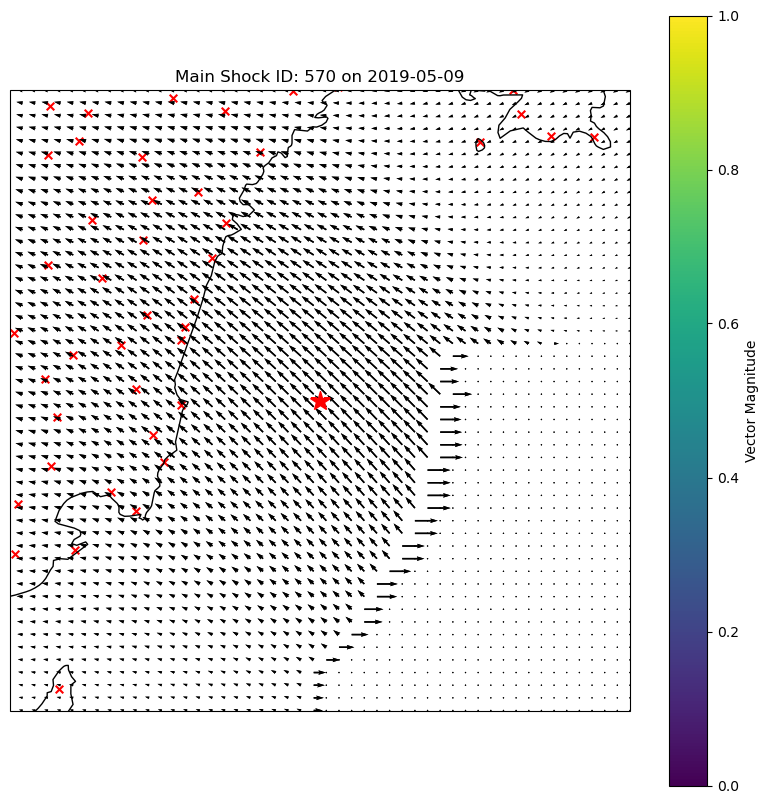

[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7, 6.0, 6.1, 6.8, 6.5, 7.2, 6.7, 6.6, 6.4, 6.2, 6.4, 6.3, 6.4, 7.8, 6.3, 7.3, 6.1, 6.2, 6.7, 6.4, 6.4, 6.3, 7.0, 6.0, 6.0, 6.1, 6.0, 6.9, 6.4, 6.5, 6.2, 6.2, 6.3, 6.6, 7.0, 6.1, 6.2, 7.0, 6.0, 6.0, 6.9, 6.6, 6.0, 6.0, 6.1, 6.0, 6.3, 6.1, 6.3, 7.3, 6.5, 6.3, 6.2, 6.2, 6.1, 6.0, 6.0, 6.4, 6.2, 6.0, 6.4, 7.0, 6.1, 6.1, 6.7, 6.0, 6.9, 6.8, 8.1, 6.3, 7.1, 6.3, 6.7, 6.5, 6.5, 6.2, 6.4, 6.4, 6.7, 6.6, 6.0, 7.4, 6.3, 6.4, 6.1, 6.3, 6.1, 6.0, 6.0, 6.3, 6.1, 6.1, 6.0, 6.3, 6.7, 6.2, 6.3, 6.0, 6.2, 6.0, 6.1, 6.2, 6.3]
[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1

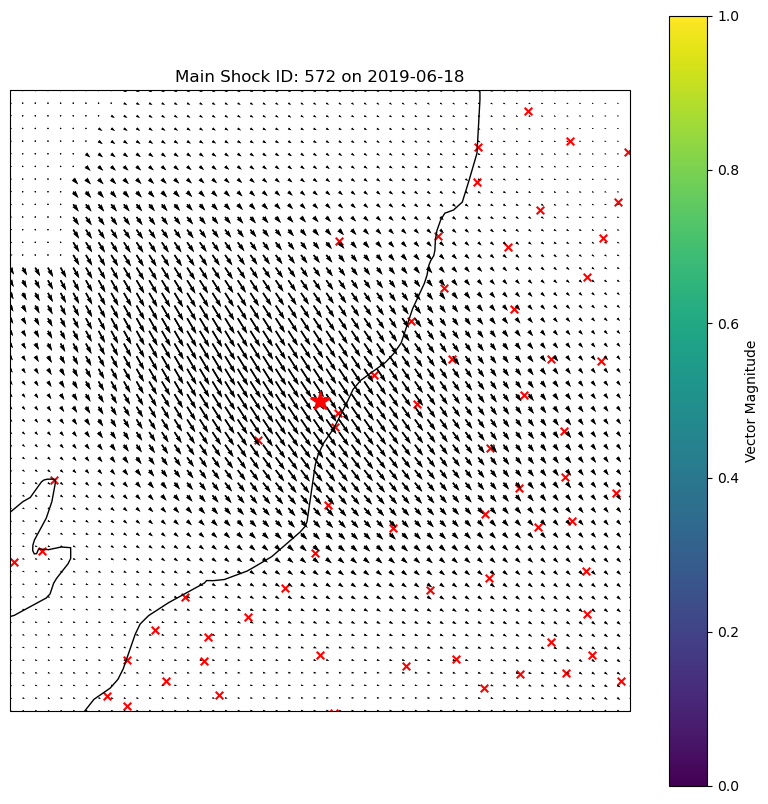

[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7, 6.0, 6.1, 6.8, 6.5, 7.2, 6.7, 6.6, 6.4, 6.2, 6.4, 6.3, 6.4, 7.8, 6.3, 7.3, 6.1, 6.2, 6.7, 6.4, 6.4, 6.3, 7.0, 6.0, 6.0, 6.1, 6.0, 6.9, 6.4, 6.5, 6.2, 6.2, 6.3, 6.6, 7.0, 6.1, 6.2, 7.0, 6.0, 6.0, 6.9, 6.6, 6.0, 6.0, 6.1, 6.0, 6.3, 6.1, 6.3, 7.3, 6.5, 6.3, 6.2, 6.2, 6.1, 6.0, 6.0, 6.4, 6.2, 6.0, 6.4, 7.0, 6.1, 6.1, 6.7, 6.0, 6.9, 6.8, 8.1, 6.3, 7.1, 6.3, 6.7, 6.5, 6.5, 6.2, 6.4, 6.4, 6.7, 6.6, 6.0, 7.4, 6.3, 6.4, 6.1, 6.3, 6.1, 6.0, 6.0, 6.3, 6.1, 6.1, 6.0, 6.3, 6.7, 6.2, 6.3, 6.0, 6.2, 6.0, 6.1, 6.2, 6.3, 6.7]
[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2

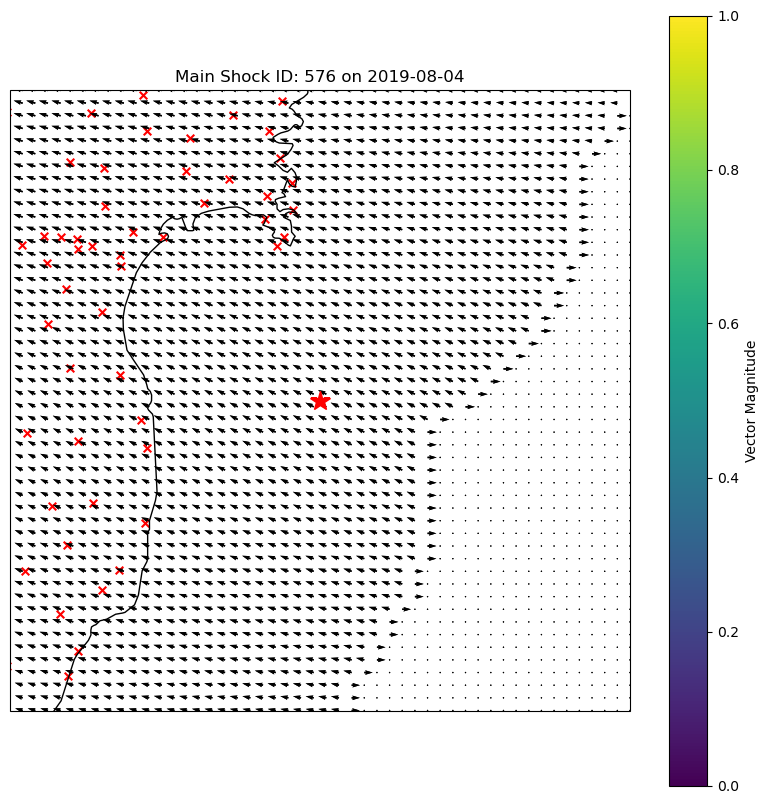

[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6, 6.4, 7.2, 6.1, 6.9, 6.0, 6.8, 7.1, 6.1, 6.6, 6.4, 6.5, 6.8, 6.5, 6.6, 6.7, 6.0, 6.1, 6.8, 6.5, 7.2, 6.7, 6.6, 6.4, 6.2, 6.4, 6.3, 6.4, 7.8, 6.3, 7.3, 6.1, 6.2, 6.7, 6.4, 6.4, 6.3, 7.0, 6.0, 6.0, 6.1, 6.0, 6.9, 6.4, 6.5, 6.2, 6.2, 6.3, 6.6, 7.0, 6.1, 6.2, 7.0, 6.0, 6.0, 6.9, 6.6, 6.0, 6.0, 6.1, 6.0, 6.3, 6.1, 6.3, 7.3, 6.5, 6.3, 6.2, 6.2, 6.1, 6.0, 6.0, 6.4, 6.2, 6.0, 6.4, 7.0, 6.1, 6.1, 6.7, 6.0, 6.9, 6.8, 8.1, 6.3, 7.1, 6.3, 6.7, 6.5, 6.5, 6.2, 6.4, 6.4, 6.7, 6.6, 6.0, 7.4, 6.3, 6.4, 6.1, 6.3, 6.1, 6.0, 6.0, 6.3, 6.1, 6.1, 6.0, 6.3, 6.7, 6.2, 6.3, 6.0, 6.2, 6.0, 6.1, 6.2, 6.3, 6.7, 6.0, 6.4]
[6.1, 6.5, 6.4, 6.1, 6.1, 6.1, 6.0, 7.1, 6.4, 8.0, 6.8, 6.5, 6.0, 6.7, 6.1, 7.1, 6.8, 6.3, 6.1, 6.4, 6.8, 7.0, 6.1, 6.0, 7.2, 6.5, 6.3, 6.1, 6.0, 6.6, 6.1, 6.2, 6.0, 6.2, 6.9, 6.3, 6.8, 6.7, 6.0, 6.6

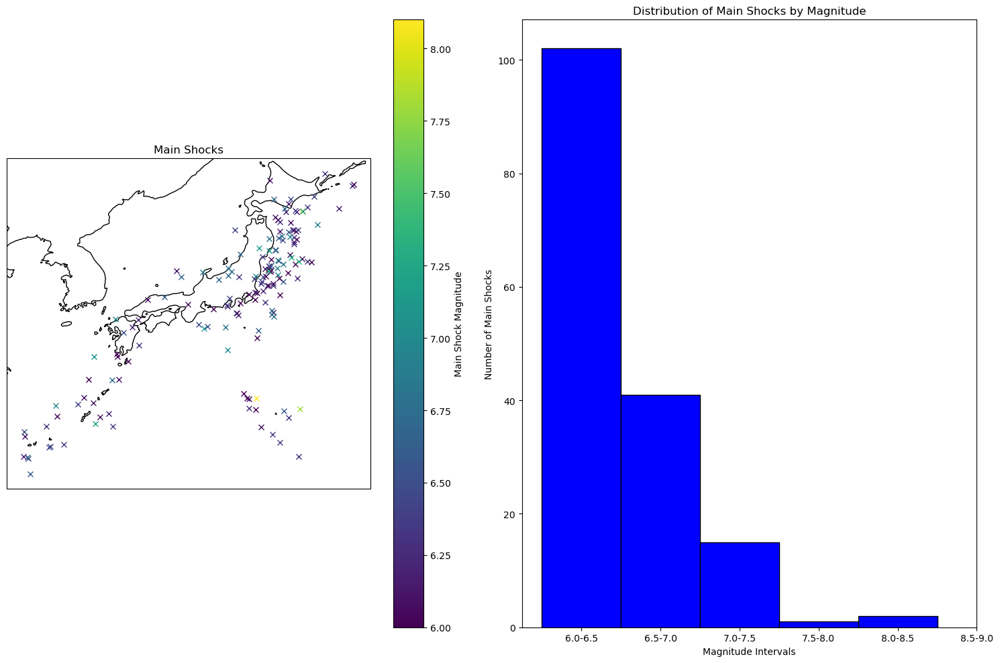

Number of sequences processed: 161
Number of sequences discarded: 91
Number of sequences kept: 70


In [75]:
def main():
    process_main_shock_data(hdf5_in_put_file_path, hdf5_out_put_file_path)
    print(main_shock_magnitudes)
    plot_main_shocks()


if __name__ == '__main__':
    main()
    print('Number of sequences processed:', n_seq_init)
    print('Number of sequences discarded:', n_seq_discarded)
    print('Number of sequences kept:', n_seq_init - n_seq_discarded)